# Set the Environment

In [71]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.compose import ColumnTransformer
from sklearn.metrics import confusion_matrix, plot_roc_curve, roc_curve, auc, roc_auc_score, PrecisionRecallDisplay, RocCurveDisplay, f1_score

from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.svm import LinearSVC
#from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV

pd.set_option('display.max_rows', 10000)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

import catboost
from catboost import *
from catboost import datasets
from catboost import CatBoostClassifier

from collections import Counter

# Load Data

In [41]:
df_train_raw = pd.read_csv(filepath_or_buffer='training_grover.csv', sep=';', index_col='Unnamed: 0')

df_train_raw.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 21 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   x.0     2671 non-null   object
 1   x.1     2671 non-null   object
 2   x.2     2671 non-null   object
 3   x.3     2671 non-null   object
 4   x.4     2671 non-null   object
 5   x.5     2671 non-null   object
 6   x.6     2671 non-null   object
 7   x.7     2671 non-null   object
 8   x.8     2671 non-null   object
 9   x.9     2671 non-null   object
 10  x.10    2671 non-null   object
 11  x.11    2671 non-null   object
 12  x.12    2671 non-null   object
 13  x.13    2671 non-null   object
 14  x.14    2671 non-null   object
 15  x.20    2671 non-null   object
 16  x.17    2671 non-null   object
 17  x.18    2671 non-null   object
 18  x.19    2671 non-null   object
 19  x.16    2671 non-null   object
 20  y       2671 non-null   object
dtypes: object(21)
memory usage: 459.1+ KB


In [46]:
df_train_raw.head()

,x.0,x.1,x.2,x.3,x.4,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.19,x.16,y
0,b,"30,83",f,u,g,w,v,1.25,t,t,t,f,g,202.0,f,t,"116,94256980957068","0,5787085579422866",202000.0,f,good
1,a,"58,67",4.46,u,g,q,h,3.04,t,t,6,f,g,43.0,560,t,"225,60625307204938","25,409645364400404",43000.0,f,good
2,a,"24,5",0.5,u,g,q,h,1.5,t,f,f,f,g,280.0,824,t,"92,08407670672422","2,3173371593153314",280000.0,f,good
3,b,"27,83",1.54,u,g,w,v,3.75,t,t,5,t,g,100.0,3,t,"104,16291777029285","8,04533772976642",100000.0,f,good
4,b,"20,17",5.625,u,g,w,v,1.71,t,f,f,f,s,120.0,f,t,"77,8703024439662","31,111460957322073",120000.0,f,good


In [43]:
df_val_raw = pd.read_csv('validation_grover.csv', sep=';', index_col='Unnamed: 0')

df_val_raw.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 490 entries, 200 to 689
Data columns (total 21 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   x.0     490 non-null    object
 1   x.1     490 non-null    object
 2   x.2     490 non-null    object
 3   x.3     490 non-null    object
 4   x.4     490 non-null    object
 5   x.5     490 non-null    object
 6   x.6     490 non-null    object
 7   x.7     490 non-null    object
 8   x.8     490 non-null    object
 9   x.9     490 non-null    object
 10  x.10    490 non-null    object
 11  x.11    490 non-null    object
 12  x.12    490 non-null    object
 13  x.13    490 non-null    object
 14  x.14    490 non-null    object
 15  x.20    490 non-null    object
 16  x.17    490 non-null    object
 17  x.18    490 non-null    object
 18  x.19    490 non-null    object
 19  x.16    490 non-null    object
 20  y       490 non-null    object
dtypes: object(21)
memory usage: 84.2+ KB


In [44]:
df_val_raw.head()

,x.0,x.1,x.2,x.3,x.4,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.19,x.16,y
200,a,"24,08",0.5,u,g,q,h,1.25,t,t,t,f,g,f,678,t,"92,74793816815001","3,2643617743722135",f,t,good
201,a,"41,33",t,u,g,i,bb,2.25,t,f,f,t,g,f,300,t,"156,577107673316","4,70468160482802",f,t,good
202,b,"24,83",2.75,u,g,c,v,2.25,t,t,6,f,g,?,600,t,"91,15015080431874","16,99038149514617",?,f,good
203,a,"20,75",10.25,u,g,q,v,0.71,t,t,2,t,g,49.0,f,t,"76,95618100795284","59,075031931843256",49000.0,t,good
204,b,"36,33",2.125,y,p,w,v,0.085,t,t,t,f,g,50.0,1187,t,"138,68766750212055","11,077167989738914",50000.0,t,good


# Exploratory Data Analysis (EDA)
- Distribution of 'Good' and 'Bad' classes in Training DS vs Validation DS
- Distribution of categorical columns by Target Variable
- Distribution of numerical columns by Target Variable
- Distribution of numerical columns by each of the categorical columns

Outcome:
- strategy for fill in missing values 
- strategy for label encoding for categorical columns
- strategy for required scaling/normalization for numerical columns
- preliminary understanding of which columns seem to be more promising in terms of predicting power

## Define Functions

In [249]:
def clean_col_type(df_raw, num_cols, cols_to_drop):
    df_clean = df_raw.drop(columns=cols_to_drop)
    
    # Convert to float all columns containing numerical values
    for col in num_cols:
        df_clean[col] = pd.to_numeric(df_clean[col].str.replace(',', '.'), errors='coerce')
        
    # Clean categorical columns (? is considered NaN)
    cat_cols = df_clean.select_dtypes(include=['object']).columns.tolist()

    for col in cat_cols:
        df_clean[col] = df_clean[col].replace('?', np.nan)
        
    return df_clean

def cumulatively_categorise(column,threshold=0.75,return_categories_list=True):

  #Find the threshold value using the percentage and number of instances in the column
  threshold_value=int(threshold*len(column))
  #Initialise an empty list for our new minimised categories
  categories_list=[]
  #Initialise a variable to calculate the sum of frequencies
  s=0
  #Create a counter dictionary of the form unique_value: frequency
  counts=Counter(column)

  #Loop through the category name and its corresponding frequency after sorting the categories by descending order of frequency
  for i,j in counts.most_common():
    #Add the frequency to the global sum
    s+=dict(counts)[i]
    #Append the category name to the list
    categories_list.append(i)
    #Check if the global sum has reached the threshold value, if so break the loop
    if s>=threshold_value:
      break
  #Append the category Other to the list
  categories_list.append('Other')

  #Replace all instances not in our new categories by Other  
  new_column=column.apply(lambda x: x if x in categories_list else 'Other')

  #Return transformed column and unique values if return_categories=True
  if(return_categories_list):
    return new_column,categories_list
  #Return only the transformed column if return_categories=False
  else:
    return new_column

def summary_cat_cols(df):
    cat_cols = df.select_dtypes(include=['object']).columns.tolist()
    ds_cat_stats = pd.DataFrame()
    
    tmp = pd.DataFrame()
    
    for c in cat_cols:
        tmp['column'] = [c]
        tmp['num_tot'] = len(df)
        tmp['values'] = [df[c].unique()]
        tmp['values_count_incna'] = len(list(df[c].unique()))
        tmp['values_count_nona'] = int(df[c].nunique())
        tmp['num_miss'] = df[c].isnull().sum()
        tmp['pct_miss'] = (df[c].isnull().sum()/ len(df)).round(3)*100
        ds_cat_stats = ds_cat_stats.append(tmp)
    
    return ds_cat_stats

def plot_cat_col_by_target(df):
    cat_cols = df.select_dtypes(include=['object']).columns.tolist()
    
    for col in cat_cols:
        sns.catplot(data=df, 
                    x=col, 
                    col='y', 
                    kind='count', 
                    sharey=False, 
                    order=sorted(df.loc[~df[col].isna()][col].unique())
                   )
        perc_na = np.round((df[col].isnull().sum()/ len(df))*100, 1)
        plt.suptitle('Distribution of {} column by Target Variable ({}% Missing Values)'.format(col, perc_na), 
                    )
        plt.tight_layout()
        plt.show()
        
def plot_hist_col_by_target(df):
    num_cols = df.select_dtypes(include=['float64']).columns.tolist()
    
    for col in num_cols:
        sns.histplot(data=df, 
                     x=col, 
                     hue='y', 
                     kde=True
                   )
        perc_na = np.round((df[col].isnull().sum()/ len(df))*100, 1)
        plt.suptitle('Distribution of {} column by Target Variable ({}% Missing Values)'.format(col, perc_na), 
                    )
        plt.tight_layout()
        plt.show()

def plot_box_col_by_target(df):
    num_cols = df.select_dtypes(include=['float64']).columns.tolist()
    
    for col in num_cols:
        sns.catplot(data=df, 
                    y=col, 
                    x='y', 
                    kind='box'
                   )
        perc_na = np.round((df[col].isnull().sum()/ len(df))*100, 1)
        plt.suptitle('Distribution of {} column by Target Variable ({}% Missing Values)'.format(col, perc_na), 
                    )
        plt.tight_layout()
        plt.show()

## First EDA on Raw Data

In [250]:
# Distribution of Target Variable in the training dataset
df_train_raw.y.value_counts(normalize=True)

good    0.897791
bad     0.102209
Name: y, dtype: float64

In [251]:
# Distribution of Target Variable in the validation dataset
df_val_raw.y.value_counts(normalize=True)

bad     0.685714
good    0.314286
Name: y, dtype: float64

- It looks like there is a quite big class imbalance in the training dataset. 
- In the validation dataset, there is less imbalance between the two classes, but the proportion is reversed compared to the training dataset

In [252]:
ds_cat_stats_tr_raw = summary_cat_cols(df_train_raw)
ds_cat_stats_val_raw = summary_cat_cols(df_val_raw)

ds_cat_stats_tr_raw

,column,num_tot,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,x.0,2671,"[b, a, ?]",3,3,0,0.0
0,x.1,2671,"[30,83, 58,67, 24,5, 27,83, 20,17, 32,08, 33,1...",292,292,0,0.0
0,x.2,2671,"[f, 4.46, 0.5, 1.54, 5.625, 4.0, 1.04, 11.585,...",178,178,0,0.0
0,x.3,2671,"[u, y, ?, l]",4,4,0,0.0
0,x.4,2671,"[g, p, ?, gg]",4,4,0,0.0
0,x.5,2671,"[w, q, m, r, cc, k, c, d, x, i, e, aa, ff, j, ?]",15,15,0,0.0
0,x.6,2671,"[v, h, bb, ff, j, z, ?, o, dd, n]",10,10,0,0.0
0,x.7,2671,"[1.25, 3.04, 1.5, 3.75, 1.71, 2.5, 6.5, 0.04, ...",120,120,0,0.0
0,x.8,2671,"[t, b, a, c]",4,4,0,0.0
0,x.9,2671,"[t, f]",2,2,0,0.0


In [253]:
ds_cat_stats_val_raw

,column,num_tot,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,x.0,490,"[a, b, ?]",3,3,0,0.0
0,x.1,490,"[24,08, 41,33, 24,83, 20,75, 36,33, 35,42, 71,...",289,289,0,0.0
0,x.2,490,"[0.5, t, 2.75, 10.25, 2.125, 12.0, f, 9.335, 2...",177,177,0,0.0
0,x.3,490,"[u, y, ?, l]",4,4,0,0.0
0,x.4,490,"[g, p, ?, gg]",4,4,0,0.0
0,x.5,490,"[q, i, c, w, ?, k, cc, d, ff, aa, e, x, m, j, r]",15,15,0,0.0
0,x.6,490,"[h, bb, v, ?, ff, z, o, dd, n, j]",10,10,0,0.0
0,x.7,490,"[1.25, 2.25, 0.71, 0.085, 14.0, f, 5.665, 4.5,...",94,94,0,0.0
0,x.8,490,"[t, a, b, c]",4,4,0,0.0
0,x.9,490,"[t, f]",2,2,0,0.0


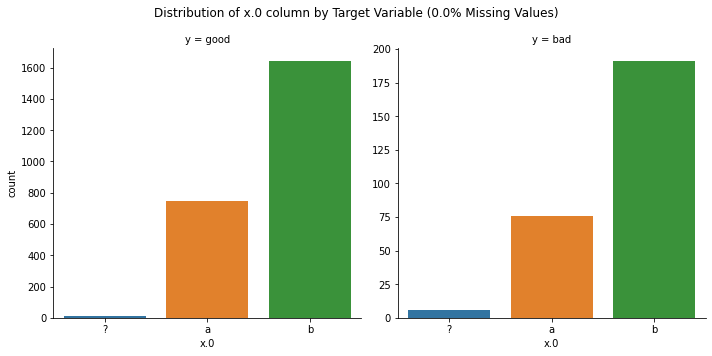

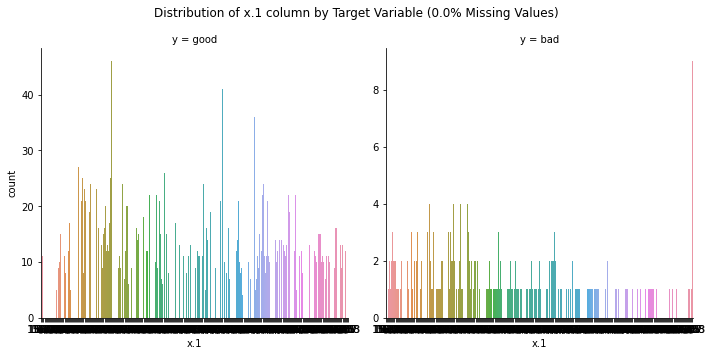

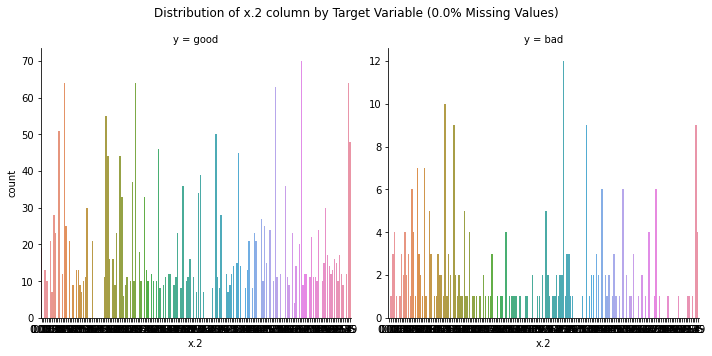

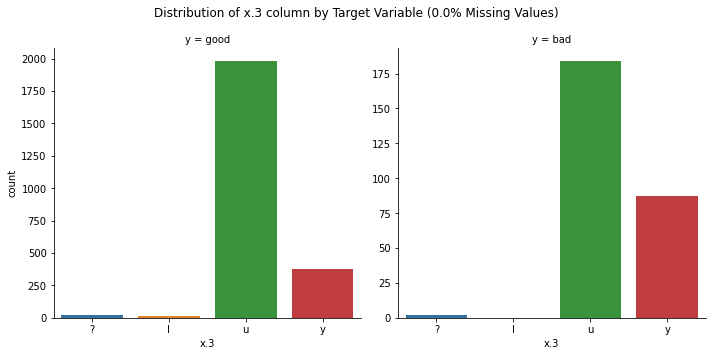

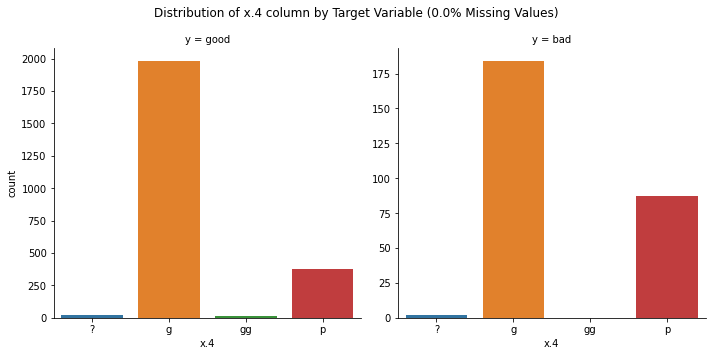

...

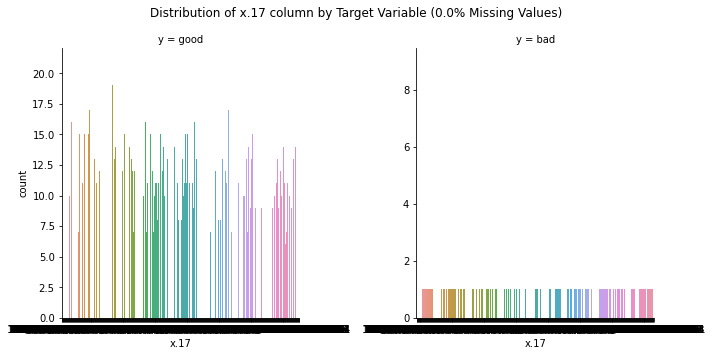

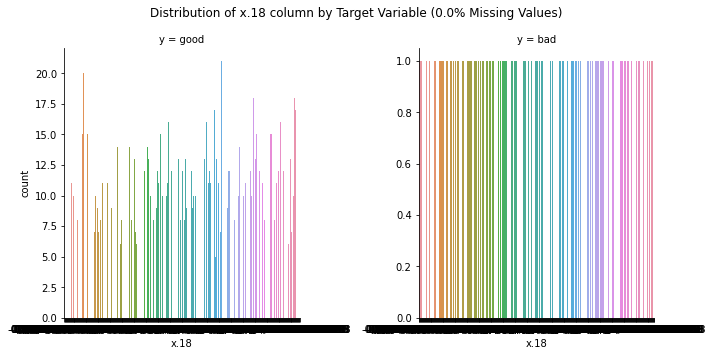

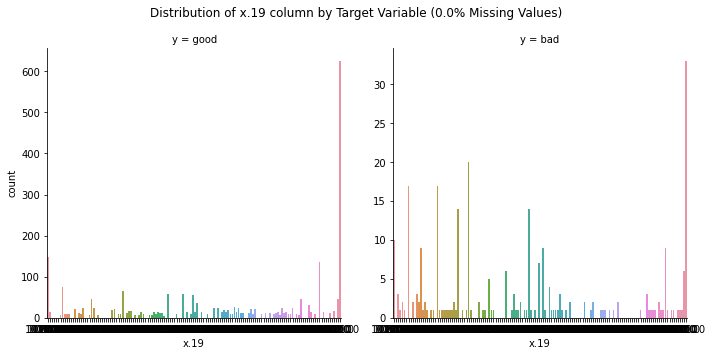

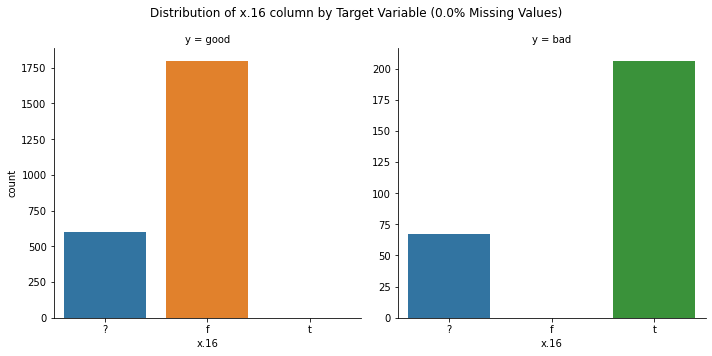

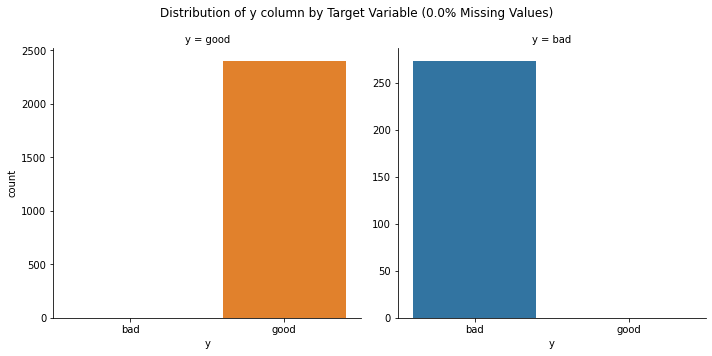

In [56]:
plot_cat_col_by_target(df_train_raw)

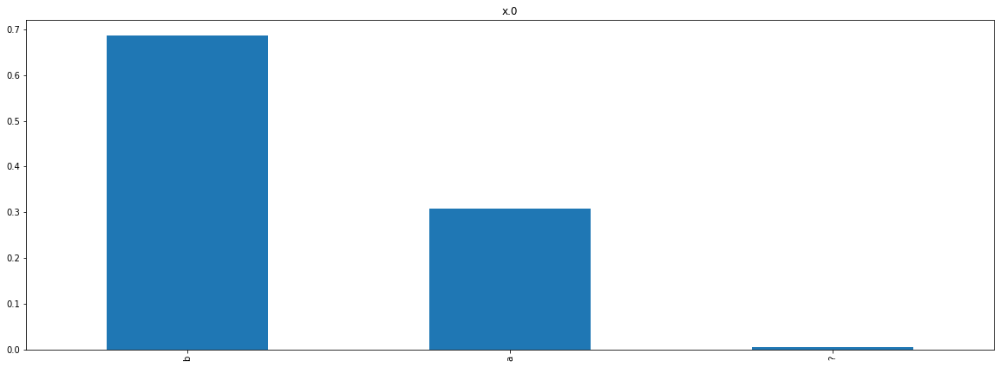

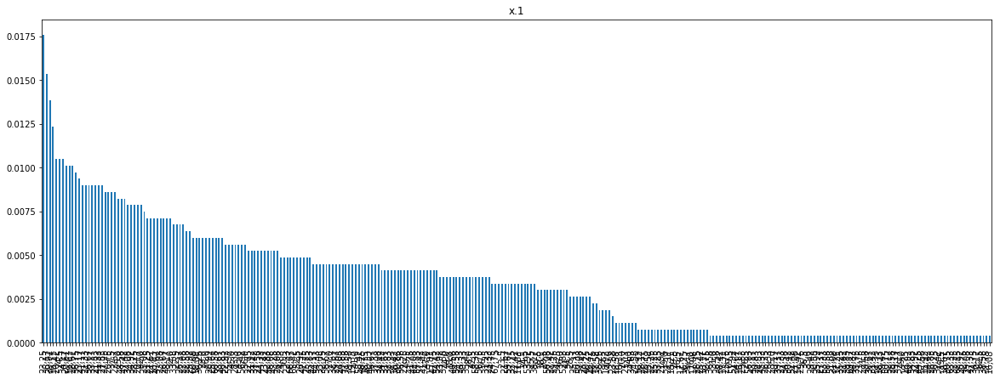

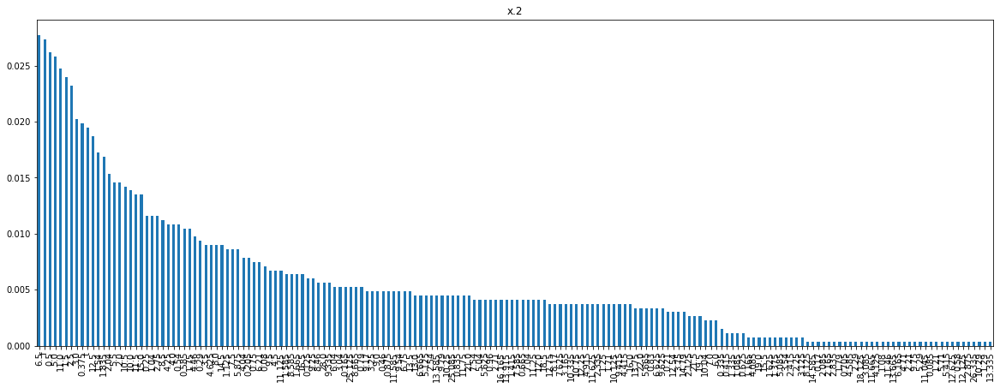

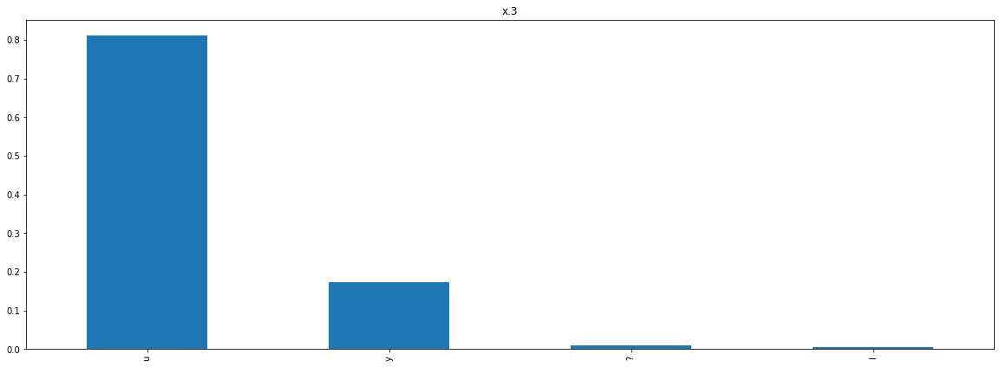

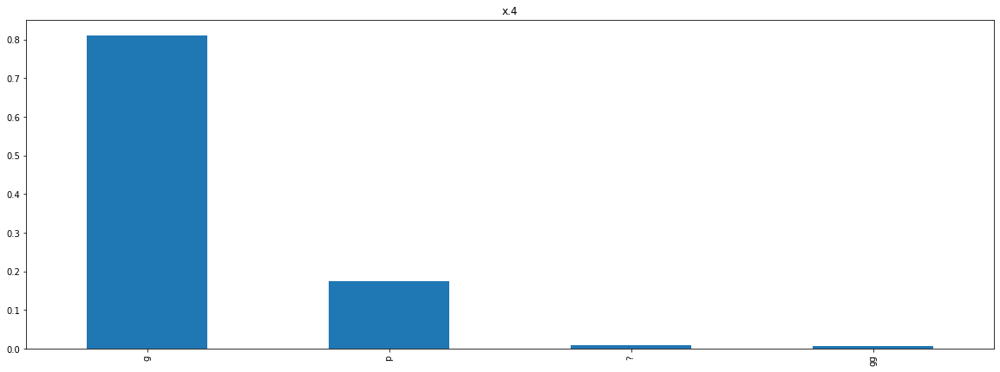

...

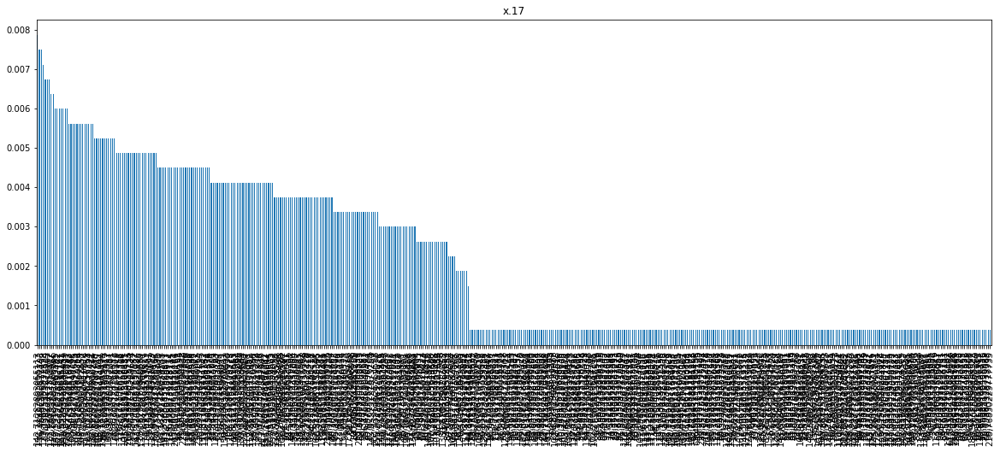

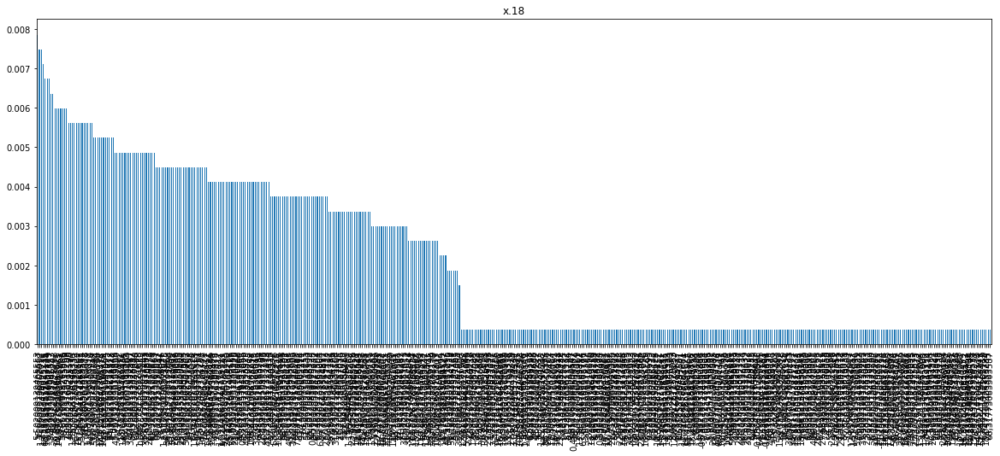

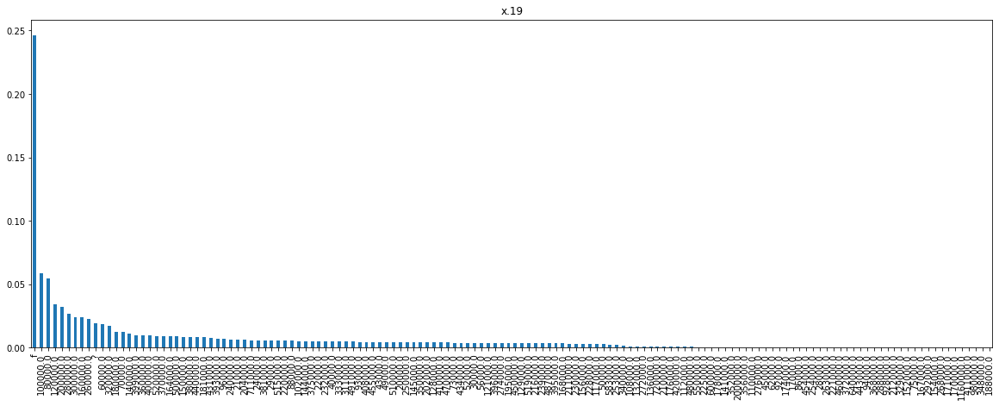

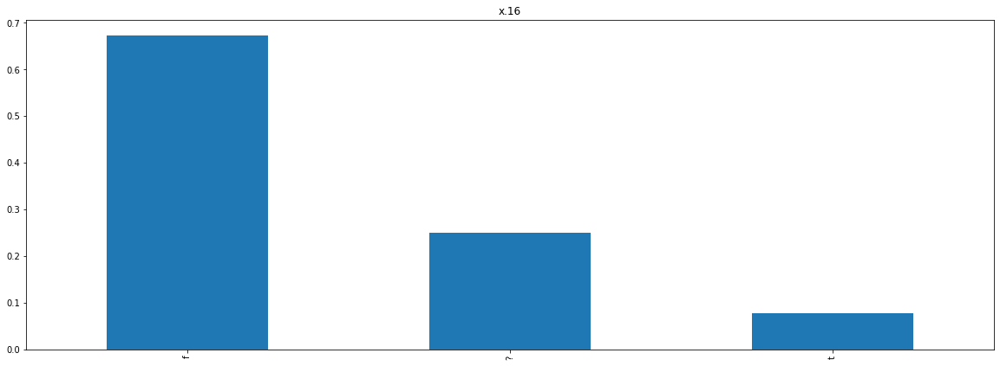

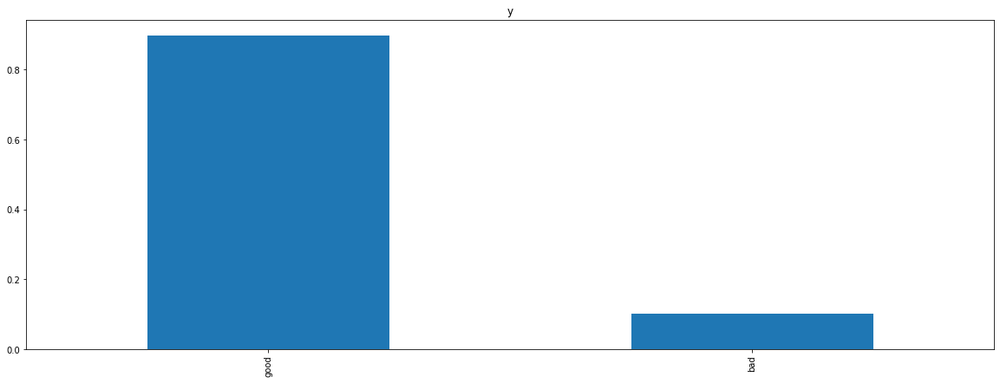

In [51]:
for col in df_train_raw.columns.tolist():
    df_train_raw[col].value_counts(normalize=True).plot(kind='bar', figsize=(20, 7))
    plt.title(col)
    plt.show()

- columns 'x.1', 'x.2', 'x.7', 'x.17', 'x.18' seem to be representing continuous values --> we will replace values 't' and 'f' will NaN
- columns 'x.10', 'x.13', 'x.14', 'x.19' also contains a mix of numerical and string values

- columns 'x.13' and 'x.19' seem to have different values but exactly the same distribution --> we will keep only one of them
- columns 'x.3' and 'x.4' also seem to be a duplicated --> we will keep only one of them
- column **'x.14'** looks pretty weird. Almost 40% of rows in the training dataset have the same value 'f' --> we will **exclude** this column

- column **'x.10'** has numerical values, but majority of rows have 'f' and 't' as value. We could interprert this as missing values or consider the column as categorical --> we will **exclude** this column
- column **'x.13'** has numerical values, but majority of rows have 'f' as value. We could interprert this as missing values or consider the column as categorical --> we will **exclude** this column
- columns 'x.5' and 'x.6' seem to have a high cardinality. We will need to consider this when encoding the variable
- column **'x.20'** has majority of values as '?' --> we can interpret this as missing values, so we wil **exclude** the column


Columns to exclude:
['x.10', 'x.13', 'x.14', 'x.16', 'x.19', 'x.20']

x.0, x.1, x.2, x.3, x.4, x.5, x.6, x.7, x.8, x.9, x.11, x.12, x.17, x.18, y	


x.0_b	x.3_u	x.3_y	x.4_gg	x.4_p	x.8_b	x.8_c	x.8_t	x.9_t	x.11_t	x.12_p	x.12_s


In conclusion, we will:
- Consider '?' as missing value (NaN)
- Convert columns into numerical columns (any error will become NaN): ['x.1', 'x.2', 'x.7', 'x.10', 'x.13', 'x.14', 'x.17', 'x.18', 'x.19']
- exclude all columns with > 25% of missing values

In [17]:
df_train_raw['x.14'].nunique()

178

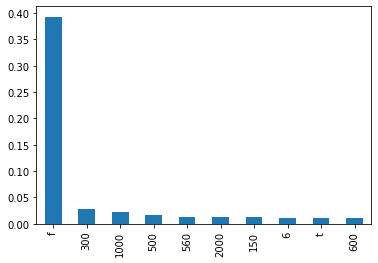

In [18]:
df_train_raw['x.14'].value_counts(normalize=True)[:10].plot(kind='bar')

plt.show()

In [19]:
df_train_raw.groupby(['x.13', 'x.19'])['x.0'].count()

x.13    x.19     
100.0   100000.0     157
102.0   102000.0      13
108.0   108000.0       3
110.0   110000.0       1
112.0   112000.0       2
1160.0  1160000.0      1
117.0   117000.0       7
120.0   120000.0      92
121.0   121000.0      10
128.0   128000.0      11
129.0   129000.0       9
132.0   132000.0       3
136.0   136000.0       2
140.0   140000.0      30
141.0   141000.0       1
144.0   144000.0      13
145.0   145000.0      11
150.0   150000.0      23
152.0   152000.0       1
154.0   154000.0       1
156.0   156000.0       8
160.0   160000.0      63
164.0   164000.0      24
167.0   167000.0       1
168.0   168000.0       9
17.0    17000.0        1
170.0   170000.0       1
171.0   171000.0       1
174.0   174000.0       1
176.0   176000.0       2
178.0   178000.0       1
180.0   180000.0      33
181.0   181000.0      22
188.0   188000.0       1
195.0   195000.0       9
20.0    20000.0       11
200.0   200000.0      86
2000.0  2000000.0      1
202.0   202000.0      11
204.0  

In [20]:
df_train_raw.groupby(['x.3', 'x.4'])['x.0'].count()

x.3  x.4
?    ?        24
l    gg       17
u    g      2166
y    p       464
Name: x.0, dtype: int64

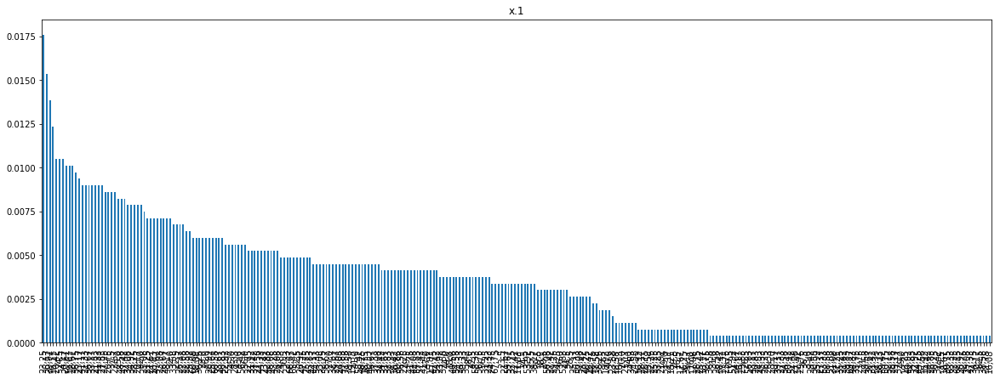

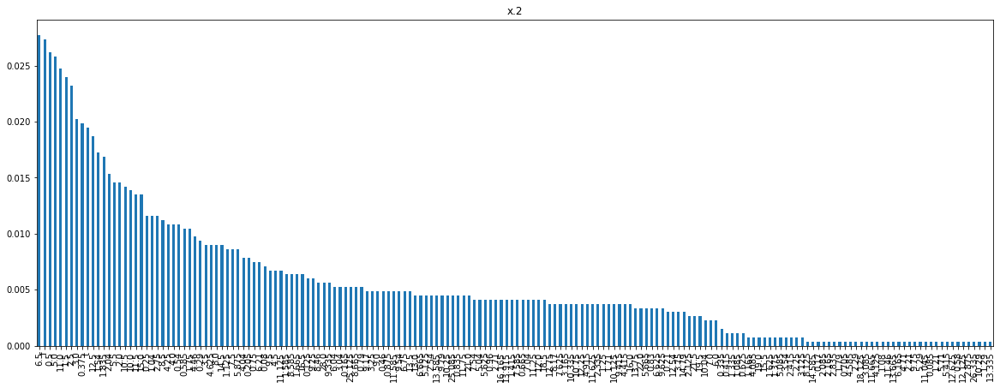

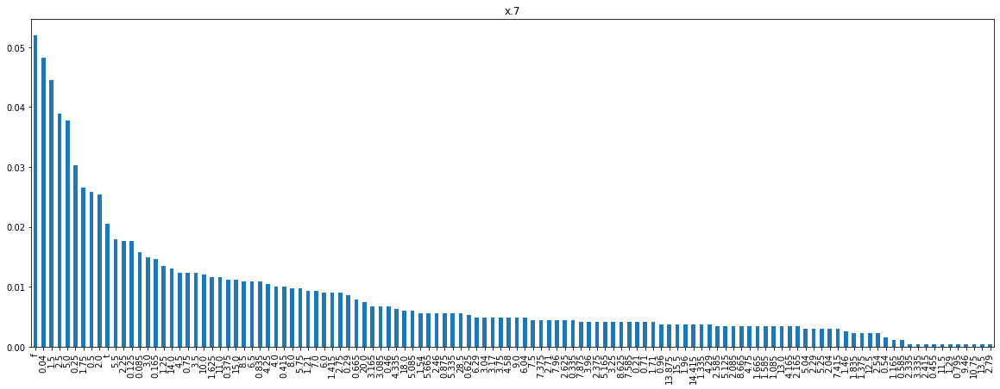

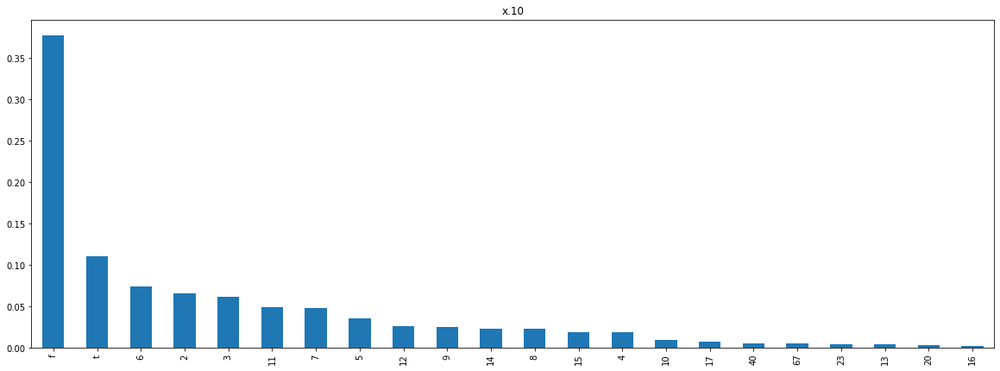

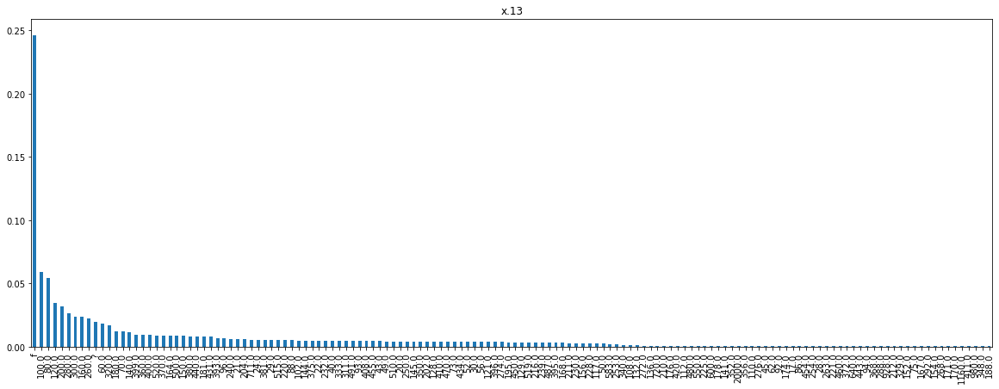

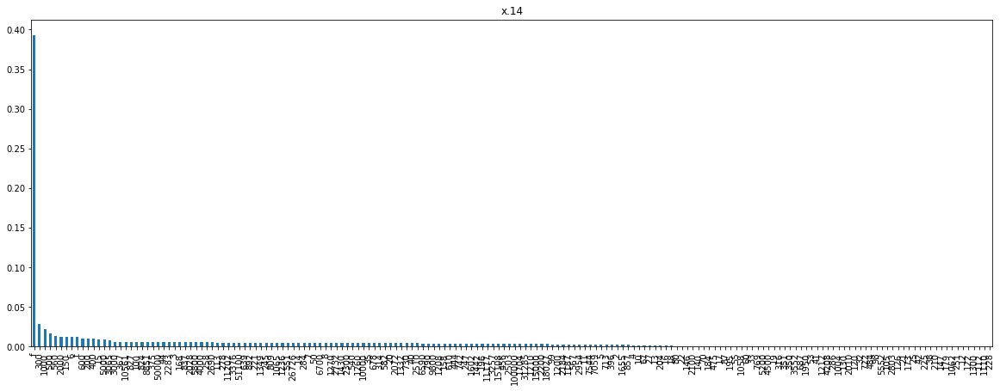

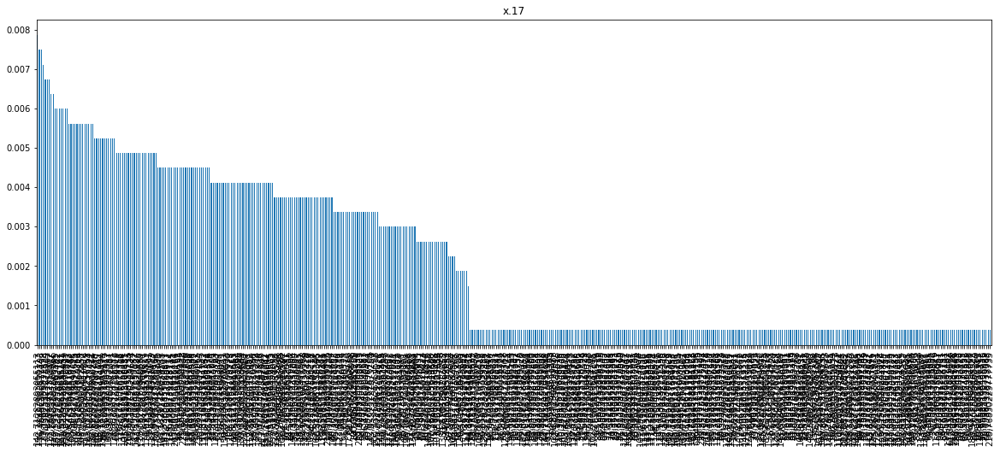

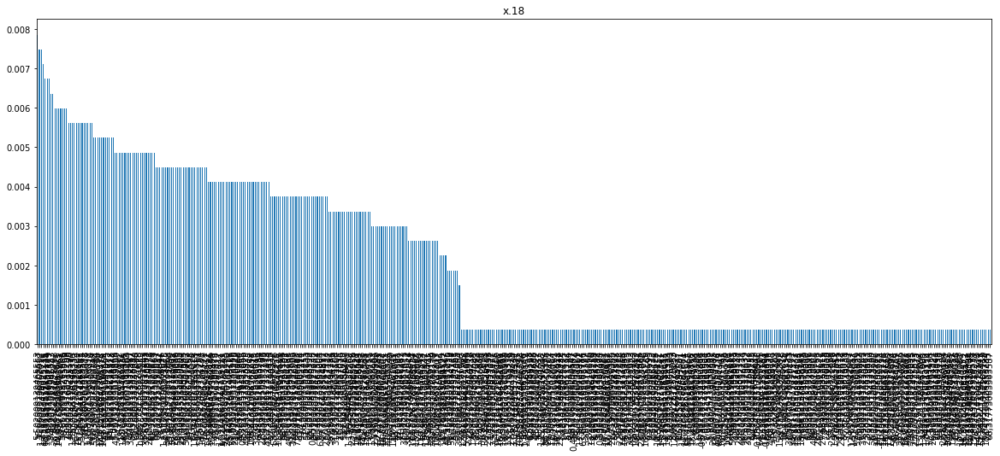

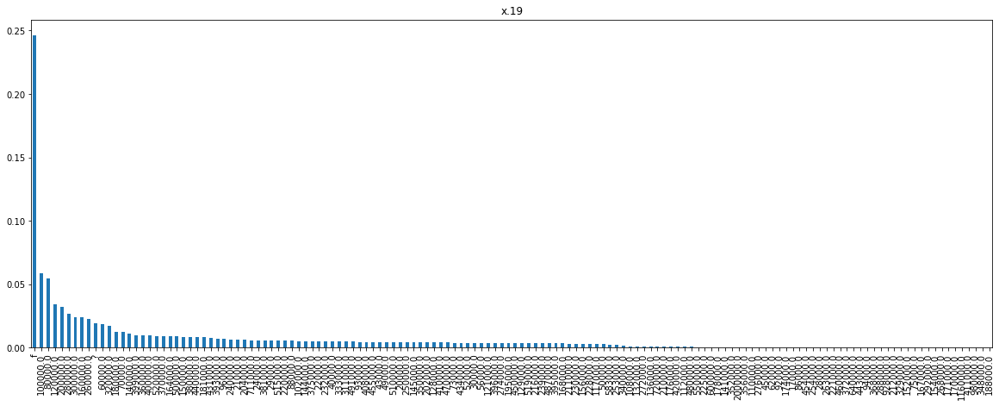

In [22]:
#num_cols = ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']
num_cols = ['x.1', 'x.2', 'x.7', 'x.10', 'x.13', 'x.14', 'x.17', 'x.18', 'x.19']

for col in num_cols:
    df_train_raw[col].value_counts(normalize=True).plot(kind='bar', figsize=(20, 7))
    plt.title(col)
    plt.show()

## Data Cleaning (Column Types)

- convert columns ['x.1', 'x.2', 'x.7', 'x.17', 'x.18'] into numerical columns (errors converted to NaN)
- all other columns we will consider as categorical (One-hot encoded)
- drop column x.19 as equivalent to column x.13
- drop column x.4 as equivalent to column x.3
- columns x.5, x.6, x.10 and x.14 have high carinality (cardinality will be reduced by considering the top 4 most frequent values and aggregating the remaining into a new 'other' category

Maybe:
- column x.14 has high prevalence of class 'f' --> we will convert it into a 2-level categorical variable (f, other)

In [32]:
#def clean_col_type_old(df_raw, num_cols):
#    df_clean = df_raw.copy()
#    
#    # Convert to float all columns containing numerical values
#    for col in num_cols:
#        df_clean[col] = pd.to_numeric(df_clean[col].str.replace(',', '.'), errors='coerce')
#    
#    ## Clean categorical columns (? is considered NaN)
#    #cat_cols = df_clean.select_dtypes(include=['object']).columns.tolist()
##
#    #for col in cat_cols:
#    #    df_clean[col] = df_clean[col].replace('?', 'other')
#        
#    return df_clean

#def clean_col_type(df_raw, num_cols, cols_to_drop):
#    df_clean = df_raw.drop(columns=cols_to_drop)
#    
#    # Convert to float all columns containing numerical values
#    for col in num_cols:
#        df_clean[col] = pd.to_numeric(df_clean[col].str.replace(',', '.'), errors='coerce')
#        
#    return df_clean

In [255]:
#num_cols = ['x.1', 'x.2', 'x.7', 'x.10', 'x.13', 'x.14', 'x.17', 'x.18', 'x.19']
num_cols = ['x.1', 'x.2', 'x.7', 'x.10', 'x.13', 'x.14', 'x.17', 'x.18']
#num_cols = ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']
cols_to_drop = ['x.4', 'x.19']

df_train = clean_col_type(df_train_raw, num_cols, cols_to_drop)
#df_train['x.14'] = np.where(df_train['x.14'] == 'f', 'f', 'other')
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.0     2656 non-null   object 
 1   x.1     2662 non-null   float64
 2   x.2     2546 non-null   float64
 3   x.3     2647 non-null   object 
 4   x.5     2646 non-null   object 
 5   x.6     2646 non-null   object 
 6   x.7     2477 non-null   float64
 7   x.8     2671 non-null   object 
 8   x.9     2671 non-null   object 
 9   x.10    1366 non-null   float64
 10  x.11    2671 non-null   object 
 11  x.12    2671 non-null   object 
 12  x.13    1961 non-null   float64
 13  x.14    1590 non-null   float64
 14  x.20    491 non-null    object 
 15  x.17    2662 non-null   float64
 16  x.18    2671 non-null   float64
 17  x.16    2003 non-null   object 
 18  y       2671 non-null   object 
dtypes: float64(8), object(11)
memory usage: 481.9+ KB


In [256]:
df_train.head()

,x.0,x.1,x.2,x.3,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.16,y
0,b,30.83,NaN,u,w,v,1.25,t,t,NaN,f,g,202.0,NaN,t,116.942570,0.578709,f,good
1,a,58.67,4.460,u,q,h,3.04,t,t,6.0,f,g,43.0,560.0,t,225.606253,25.409645,f,good
2,a,24.50,0.500,u,q,h,1.50,t,f,NaN,f,g,280.0,824.0,t,92.084077,2.317337,f,good
3,b,27.83,1.540,u,w,v,3.75,t,t,5.0,t,g,100.0,3.0,t,104.162918,8.045338,f,good
4,b,20.17,5.625,u,w,v,1.71,t,f,NaN,f,s,120.0,NaN,t,77.870302,31.111461,f,good


In [257]:
df_val = clean_col_type(df_val_raw, num_cols, cols_to_drop)

#df_val['x.14'] = np.where(df_val['x.14'] == 'f', 'f', 'other')
df_val.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 490 entries, 200 to 689
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.0     478 non-null    object 
 1   x.1     482 non-null    float64
 2   x.2     468 non-null    float64
 3   x.3     484 non-null    object 
 4   x.5     481 non-null    object 
 5   x.6     481 non-null    object 
 6   x.7     402 non-null    float64
 7   x.8     490 non-null    object 
 8   x.9     490 non-null    object 
 9   x.10    120 non-null    float64
 10  x.11    490 non-null    object 
 11  x.12    490 non-null    object 
 12  x.13    394 non-null    float64
 13  x.14    256 non-null    float64
 14  x.20    490 non-null    object 
 15  x.17    482 non-null    float64
 16  x.18    490 non-null    float64
 17  x.16    490 non-null    object 
 18  y       490 non-null    object 
dtypes: float64(8), object(11)
memory usage: 92.7+ KB


In [258]:
df_val.head()

,x.0,x.1,x.2,x.3,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.16,y
200,a,24.08,0.500,u,q,h,1.250,t,t,NaN,f,g,NaN,678.0,t,92.747938,3.264362,t,good
201,a,41.33,NaN,u,i,bb,2.250,t,f,NaN,t,g,NaN,300.0,t,156.577108,4.704682,t,good
202,b,24.83,2.750,u,c,v,2.250,t,t,6.0,f,g,NaN,600.0,t,91.150151,16.990381,f,good
203,a,20.75,10.250,u,q,v,0.710,t,t,2.0,t,g,49.0,NaN,t,76.956181,59.075032,t,good
204,b,36.33,2.125,y,w,v,0.085,t,t,NaN,f,g,50.0,1187.0,t,138.687668,11.077168,t,good


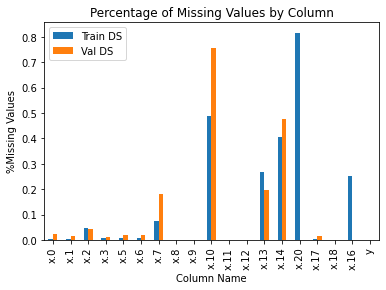

In [259]:
# Percentage of Missing Values by Columns

pd.concat([df_train.isnull().sum().div(len(df_train)), df_val.isnull().sum().div(len(df_val))], axis=1).plot(kind='bar')
plt.legend(['Train DS', 'Val DS'])
plt.title('Percentage of Missing Values by Column')
plt.xlabel('Column Name')
plt.ylabel('%Missing Values')
plt.show()

The percentage of missing values in is pretty low. We will fill in those missing values using the mode or the median

good    0.897791
bad     0.102209
Name: y, dtype: float64


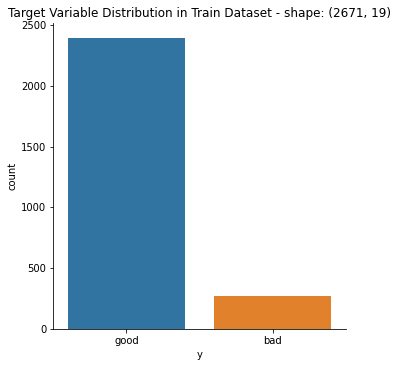

In [65]:
print(df_train.y.value_counts(normalize=True))
sns.catplot(data=df_train, 
            x='y', 
            kind='count'
           )

plt.title('Target Variable Distribution in Train Dataset - shape: {}'.format(df_train.shape))
plt.show()

bad     0.685714
good    0.314286
Name: y, dtype: float64


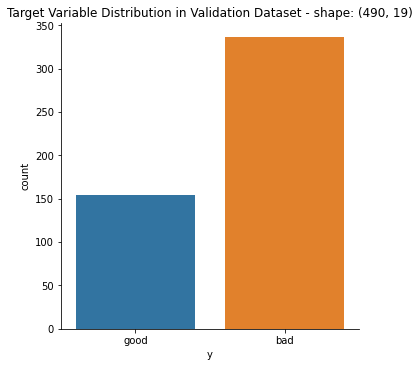

In [66]:
print(df_val.y.value_counts(normalize=True))
sns.catplot(data=df_val, 
            x='y', 
            kind='count'
           )
plt.title('Target Variable Distribution in Validation Dataset - shape: {}'.format(df_val.shape))
plt.show()

The Target Variable Distribution is different in the Training vs Validation Dataset:
- in both dataset there is some imbalance between the two classes
- in the training dataset, class 'Bad' is quite undersampled (~10% of the data)
- in the validation dataset, class 'Good' is undersampled (~30% of the data)

We need to keep this in mind while sampling for model training

## Categorical Columns

In [38]:
#def summary_cat_cols(df):
#    cat_cols = df.select_dtypes(include=['object']).columns.tolist()
#    ds_cat_stats = pd.DataFrame()
#    
#    tmp = pd.DataFrame()
#    
#    for c in cat_cols:
#        tmp['column'] = [c]
#        tmp['num_tot'] = len(df)
#        tmp['values'] = [df[c].unique()]
#        tmp['values_count_incna'] = len(list(df[c].unique()))
#        tmp['values_count_nona'] = int(df[c].nunique())
#        tmp['num_miss'] = df[c].isnull().sum()
#        tmp['pct_miss'] = (df[c].isnull().sum()/ len(df)).round(3)*100
#        ds_cat_stats = ds_cat_stats.append(tmp)
#    
#    return ds_cat_stats
#
#def plot_cat_col_by_target(df):
#    cat_cols = df.select_dtypes(include=['object']).columns.tolist()
#    
#    for col in cat_cols:
#        sns.catplot(data=df, 
#                    x=col, 
#                    col='y', 
#                    kind='count', 
#                    sharey=False, 
#                    order=sorted(df.loc[~df[col].isna()][col].unique())
#                   )
#        perc_na = np.round((df[col].isnull().sum()/ len(df))*100, 1)
#        plt.suptitle('Distribution of {} column by Target Variable ({}% Missing Values)'.format(col, perc_na), 
#                    )
#        plt.tight_layout()
#        plt.show()

In [260]:
ds_cat_stats_tr = summary_cat_cols(df_train)
ds_cat_stats_val = summary_cat_cols(df_val)

In [261]:
ds_cat_stats_tr

,column,num_tot,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,x.0,2671,"[b, a, nan]",3,2,15,0.6
0,x.3,2671,"[u, y, nan, l]",4,3,24,0.9
0,x.5,2671,"[w, q, m, r, cc, k, c, d, x, i, e, aa, ff, j, ...",15,14,25,0.9
0,x.6,2671,"[v, h, bb, ff, j, z, nan, o, dd, n]",10,9,25,0.9
0,x.8,2671,"[t, b, a, c]",4,4,0,0.0
0,x.9,2671,"[t, f]",2,2,0,0.0
0,x.11,2671,"[f, t]",2,2,0,0.0
0,x.12,2671,"[g, s, p]",3,3,0,0.0
0,x.20,2671,"[t, f, nan]",3,2,2180,81.6
0,x.16,2671,"[f, nan, t]",3,2,668,25.0


In [262]:
ds_cat_stats_val

,column,num_tot,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,x.0,490,"[a, b, nan]",3,2,12,2.4
0,x.3,490,"[u, y, nan, l]",4,3,6,1.2
0,x.5,490,"[q, i, c, w, nan, k, cc, d, ff, aa, e, x, m, j...",15,14,9,1.8
0,x.6,490,"[h, bb, v, nan, ff, z, o, dd, n, j]",10,9,9,1.8
0,x.8,490,"[t, a, b, c]",4,4,0,0.0
0,x.9,490,"[t, f]",2,2,0,0.0
0,x.11,490,"[f, t]",2,2,0,0.0
0,x.12,490,"[g, p, s]",3,3,0,0.0
0,x.20,490,"[t, f]",2,2,0,0.0
0,x.16,490,"[t, f]",2,2,0,0.0


Quick Observations

- all varaibles have the same number of distinct values excluding NaN in both training and validation dataset
- all variables, except 'x.5' and 'x.6' have <=4 distinct categories [We can use label encoding or one-hot encoding]
- variables 'x.5' and 'x.6' have 14 and 9 distinct categories [We should keep this in mind while doing the dummy variable coding]
- 2 variables ('x.16' and 'x.20') have more than 25% missing values in the training dataset [We should consider excluding these variables]

In [263]:
ds_cat_stats_tr.loc[ds_cat_stats_tr.values_count_nona >=5 ]

,column,num_tot,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,x.5,2671,"[w, q, m, r, cc, k, c, d, x, i, e, aa, ff, j, ...",15,14,25,0.9
0,x.6,2671,"[v, h, bb, ff, j, z, nan, o, dd, n]",10,9,25,0.9


In [73]:
#Call the function with a default threshold of 75%

for col in ds_cat_stats_tr.loc[ds_cat_stats_tr.values_count_nona >=5 ].column.tolist():
    
    df_train['{}_new'.format(col)] = cumulatively_categorise(df_train[col], threshold=0.6, return_categories_list=False)
    df_val['{}_new'.format(col)] = cumulatively_categorise(df_val[col], threshold=0.6, return_categories_list=False)

df_train.head()

,x.0,x.1,x.2,x.3,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.16,y,x.5_new,x.6_new,x.10_new,x.13_new,x.14_new
0,b,30.83,NaN,u,w,v,1.25,t,t,t,f,g,202.0,f,t,116.942570,0.578709,f,good,w,v,t,Other,f
1,a,58.67,4.460,u,q,h,3.04,t,t,6,f,g,43.0,560,t,225.606253,25.409645,f,good,q,h,6,Other,560
2,a,24.50,0.500,u,q,h,1.50,t,f,f,f,g,280.0,824,t,92.084077,2.317337,f,good,q,h,f,280.0,Other
3,b,27.83,1.540,u,w,v,3.75,t,t,5,t,g,100.0,3,t,104.162918,8.045338,f,good,w,v,Other,100.0,Other
4,b,20.17,5.625,u,w,v,1.71,t,f,f,f,s,120.0,f,t,77.870302,31.111461,f,good,w,v,f,120.0,f


In [74]:
df_val.head()

,x.0,x.1,x.2,x.3,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.16,y,x.5_new,x.6_new,x.10_new,x.13_new,x.14_new
200,a,24.08,0.500,u,q,h,1.250,t,t,t,f,g,f,678,t,92.747938,3.264362,t,good,q,h,Other,f,Other
201,a,41.33,NaN,u,i,bb,2.250,t,f,f,t,g,f,300,t,156.577108,4.704682,t,good,i,Other,f,f,300
202,b,24.83,2.750,u,c,v,2.250,t,t,6,f,g,?,600,t,91.150151,16.990381,f,good,c,v,Other,?,Other
203,a,20.75,10.250,u,q,v,0.710,t,t,2,t,g,49.0,f,t,76.956181,59.075032,t,good,q,v,Other,Other,f
204,b,36.33,2.125,y,w,v,0.085,t,t,t,f,g,50.0,1187,t,138.687668,11.077168,t,good,w,v,Other,Other,Other


In [264]:
summary_cat_cols(df_train)

,column,num_tot,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,x.0,2671,"[b, a, nan]",3,2,15,0.6
0,x.3,2671,"[u, y, nan, l]",4,3,24,0.9
0,x.5,2671,"[w, q, m, r, cc, k, c, d, x, i, e, aa, ff, j, ...",15,14,25,0.9
0,x.6,2671,"[v, h, bb, ff, j, z, nan, o, dd, n]",10,9,25,0.9
0,x.8,2671,"[t, b, a, c]",4,4,0,0.0
0,x.9,2671,"[t, f]",2,2,0,0.0
0,x.11,2671,"[f, t]",2,2,0,0.0
0,x.12,2671,"[g, s, p]",3,3,0,0.0
0,x.20,2671,"[t, f, nan]",3,2,2180,81.6
0,x.16,2671,"[f, nan, t]",3,2,668,25.0


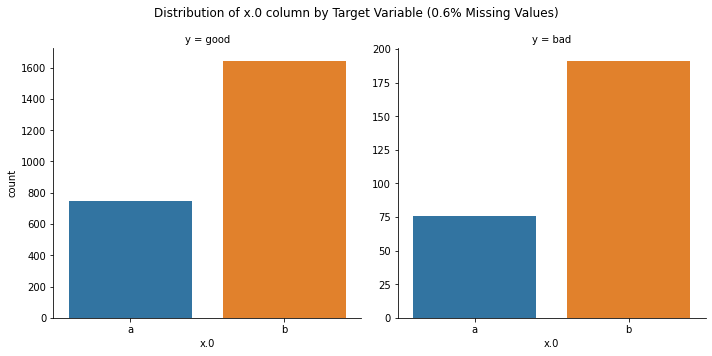

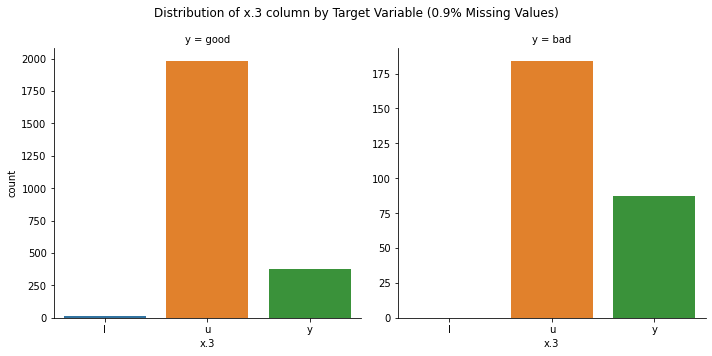

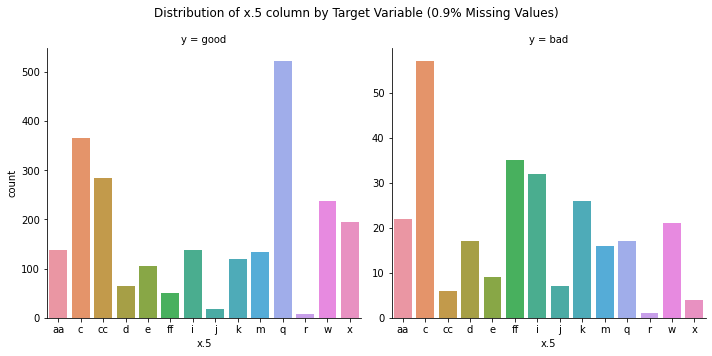

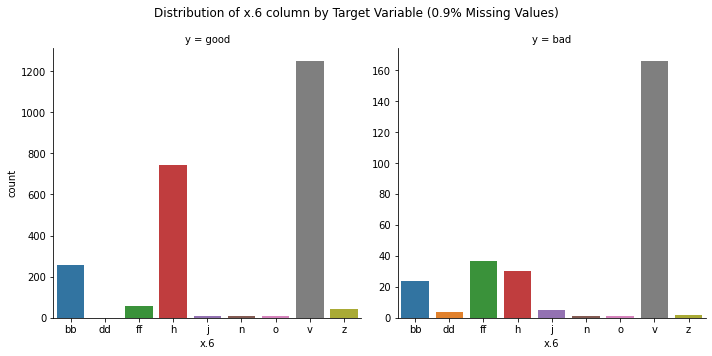

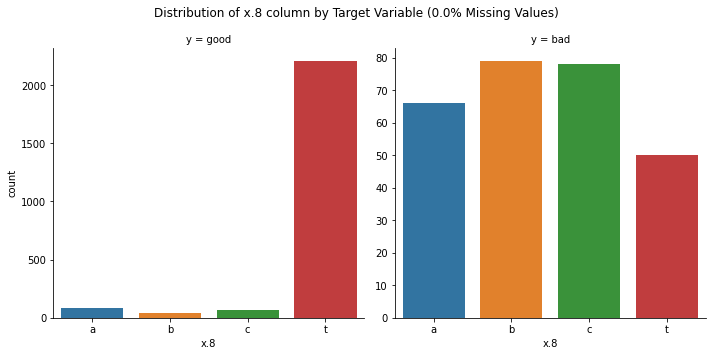

...

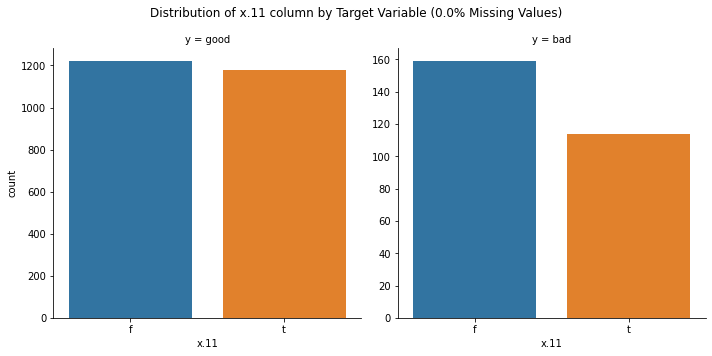

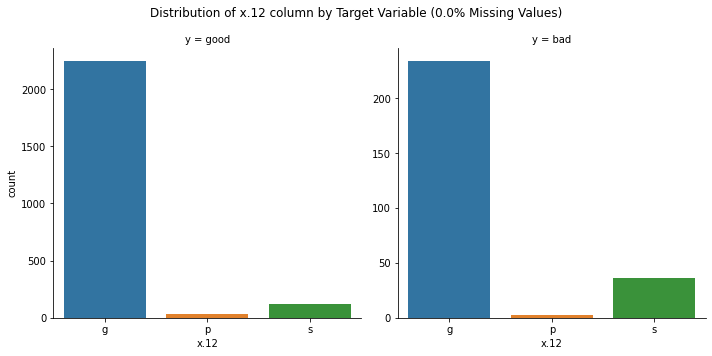

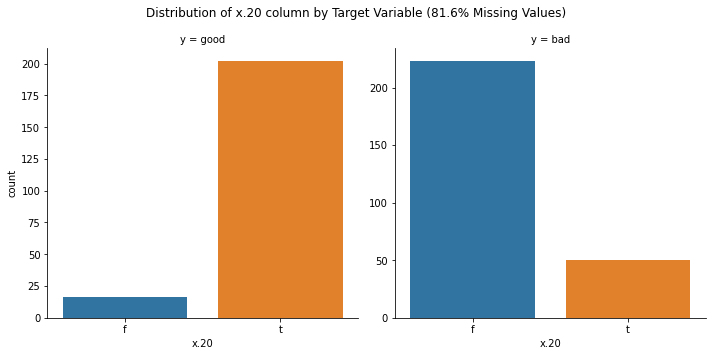

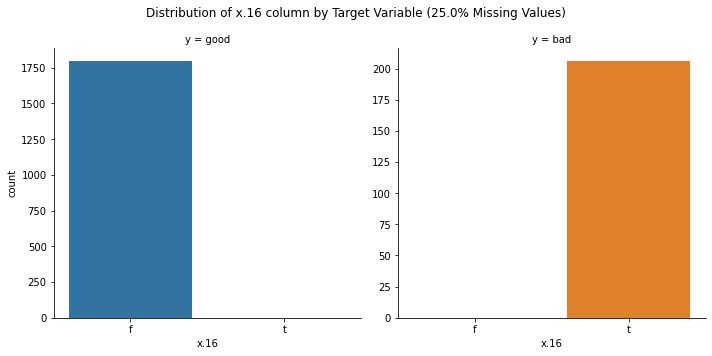

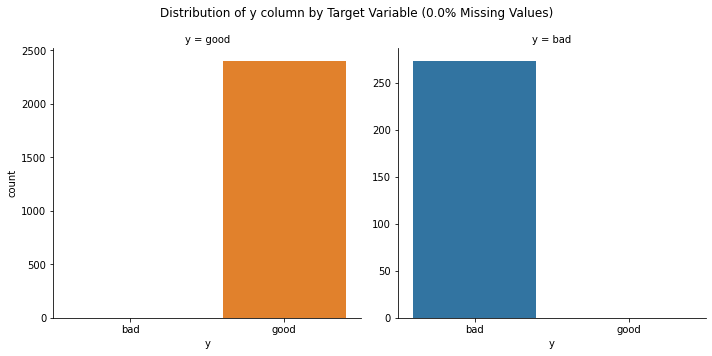

In [265]:
plot_cat_col_by_target(df_train)

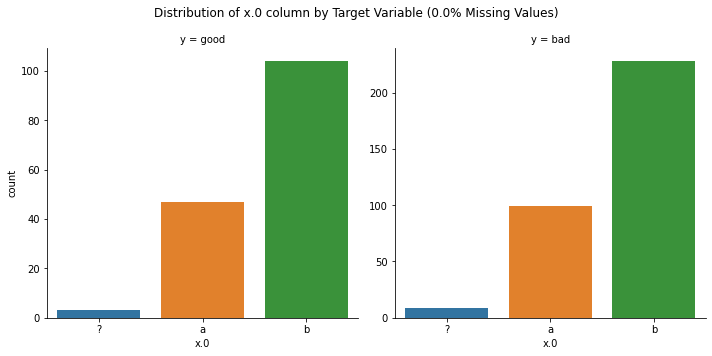

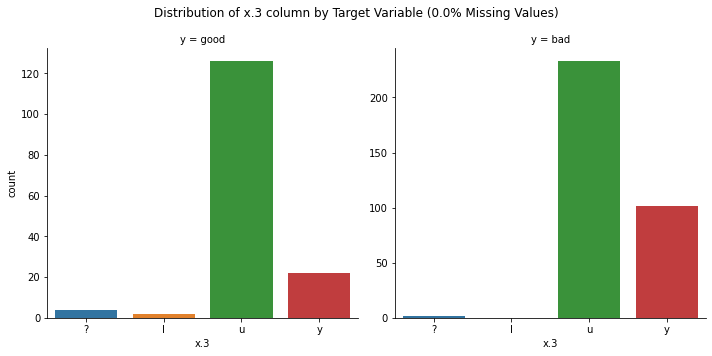

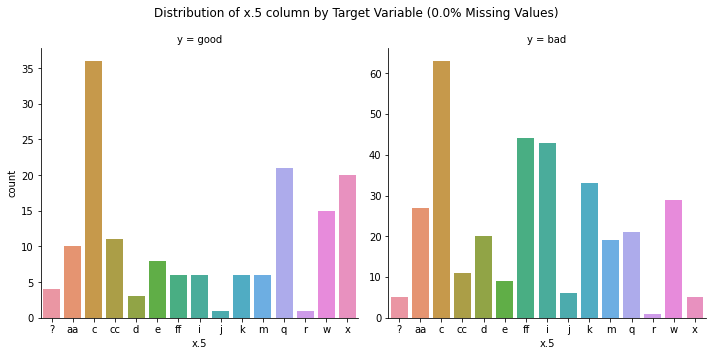

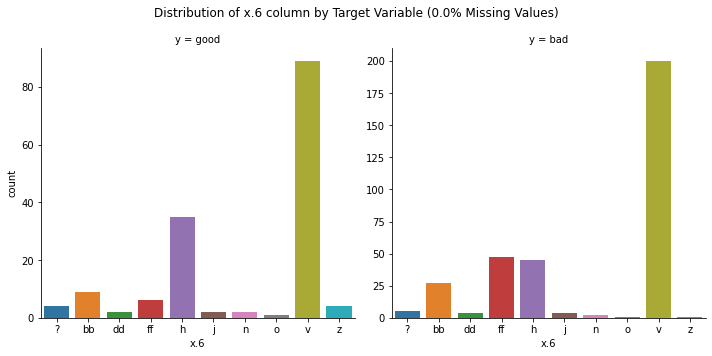

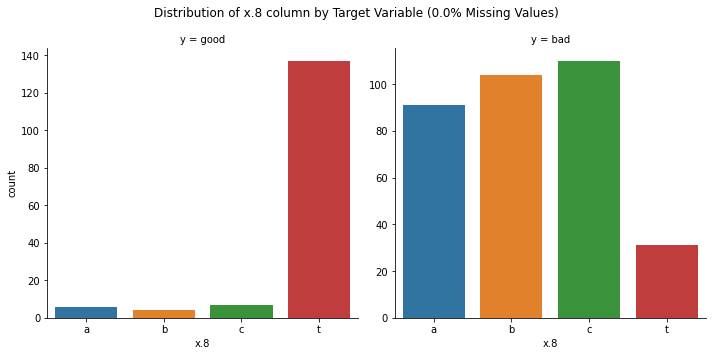

...

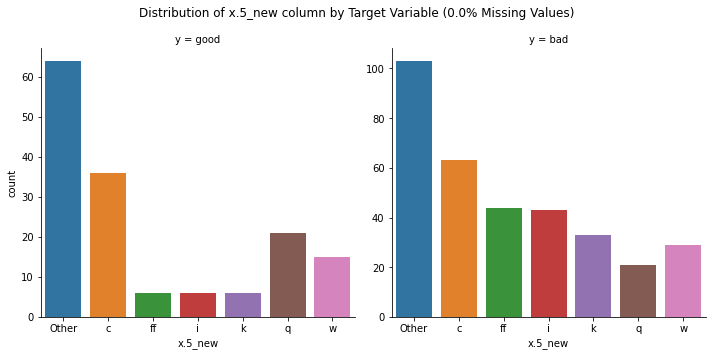

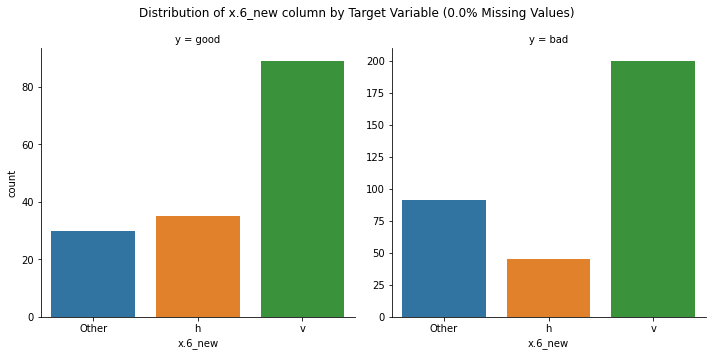

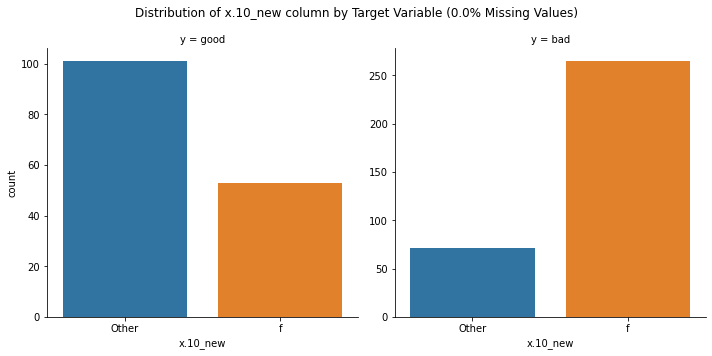

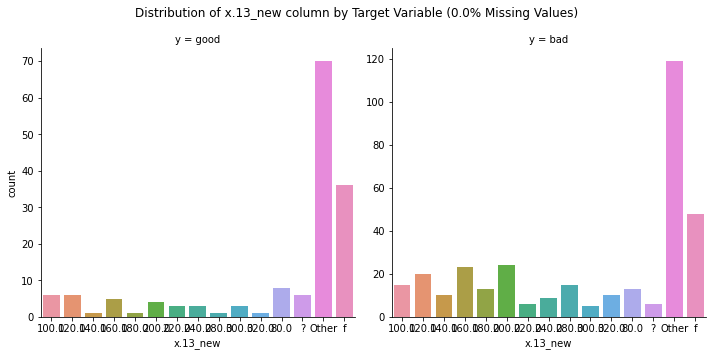

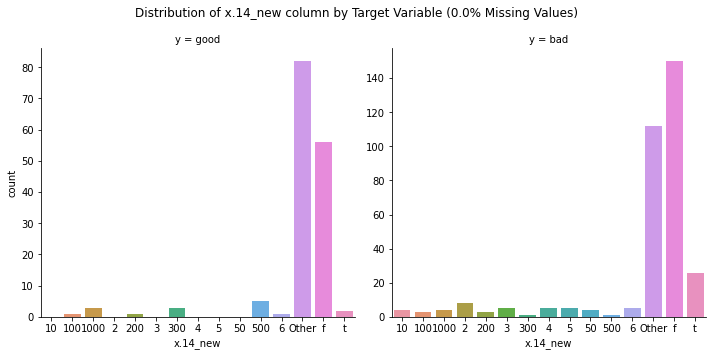

In [77]:
plot_cat_col_by_target(df_val)

- distribution of all categorical columns seems to be similar in both training and validation dataset
- 'x.0' seems to have a similar distribution in both 'Good' and 'Bad' classes
- 'x.3', 'x.4', 'x.5', 'x.6', 'x.11', 'x.12' shows some differences between 'Good' and 'Bad' classes 
- 'x.8', 'x.9', 'x.20' shows the most difference between 'Good' and 'Bad' classes

Conclusions:
- we will exclude columns 'x.16' and 'x.20' from the analysis due to the big amount of missing values and lack of knowledge about why values are missing and therefore not enough knowledge around how to fill in those missing values
- for all other columns with missing values, we will fill NaN with mode value
- we will explore correlation analysis to further understand whether to include all other columns in the model or not, in particular column 'x.0' that does not seem to show differences between 'Good' and 'Bad' classes

- we will exclude columns 'x.10' and 'x.14' from the analysis due to the big amount of missing values and lack of knowledge about why values are missing and therefore not enough knowledge around how to fill in those missing values

## Numerical Columns

In [47]:
#def plot_hist_col_by_target(df):
#    num_cols = df.select_dtypes(include=['float64']).columns.tolist()
#    
#    for col in num_cols:
#        sns.histplot(data=df, 
#                     x=col, 
#                     hue='y', 
#                     kde=True
#                   )
#        perc_na = np.round((df[col].isnull().sum()/ len(df))*100, 1)
#        plt.suptitle('Distribution of {} column by Target Variable ({}% Missing Values)'.format(col, perc_na), 
#                    )
#        plt.tight_layout()
#        plt.show()
#
#def plot_box_col_by_target(df):
#    num_cols = df.select_dtypes(include=['float64']).columns.tolist()
#    
#    for col in num_cols:
#        sns.catplot(data=df, 
#                    y=col, 
#                    x='y', 
#                    kind='box'
#                   )
#        perc_na = np.round((df[col].isnull().sum()/ len(df))*100, 1)
#        plt.suptitle('Distribution of {} column by Target Variable ({}% Missing Values)'.format(col, perc_na), 
#                    )
#        plt.tight_layout()
#        plt.show()

In [266]:
df_train.describe()

,x.1,x.2,x.7,x.10,x.13,x.14,x.17,x.18
count,2662.000000,2546.000000,2477.000000,1366.000000,1961.000000,1590.000000,2662.000000,2671.000000
mean,34.162066,6.180884,3.835440,8.395315,223.087200,3569.852830,129.152214,33.181950
std,12.436797,5.515192,4.404564,8.141538,155.282498,10548.328142,47.161287,30.967519
min,15.170000,0.080000,0.040000,2.000000,17.000000,2.000000,57.055871,-1.842044
25%,23.330000,1.585000,0.835000,4.000000,100.000000,247.000000,89.250887,7.798115
50%,32.080000,5.000000,2.460000,7.000000,181.000000,678.000000,123.433695,25.179497
75%,41.750000,10.000000,5.085000,11.000000,320.000000,2184.000000,158.157183,53.408285
max,74.830000,28.000000,28.500000,67.000000,2000.000000,100000.000000,283.707223,157.888512


In [267]:
df_val.describe()

,x.1,x.2,x.7,x.10,x.13,x.14,x.17,x.18
count,482.000000,468.000000,402.000000,120.000000,394.000000,256.000000,482.000000,490.000000
mean,30.483610,4.538226,2.000373,6.008333,228.794416,1530.652344,115.225995,24.452660
std,11.950273,4.831206,3.090601,3.998941,167.523287,6720.778589,45.267695,27.037580
min,13.750000,0.040000,0.040000,2.000000,17.000000,2.000000,52.946971,-1.842044
25%,21.920000,0.905000,0.210000,2.000000,120.000000,32.750000,82.252745,4.931513
50%,27.085000,2.687500,0.750000,5.000000,200.000000,231.000000,102.198082,14.303859
75%,36.290000,6.656250,2.405000,8.250000,298.000000,1000.000000,136.589129,34.288109
max,80.250000,26.335000,20.000000,19.000000,2000.000000,100000.000000,303.299527,148.265741


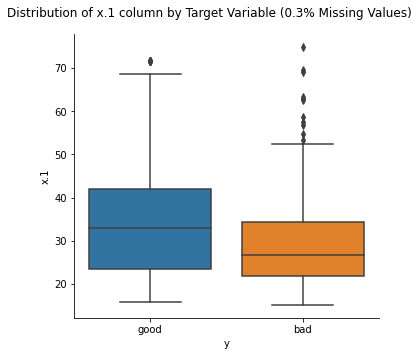

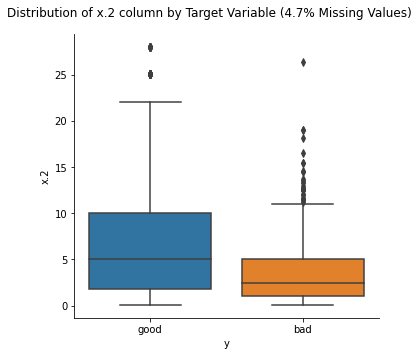

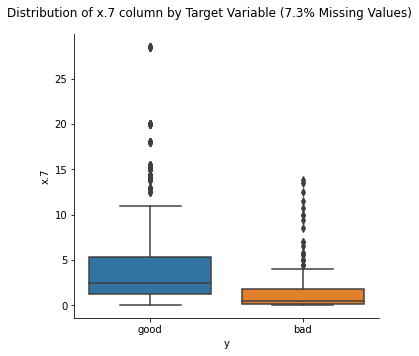

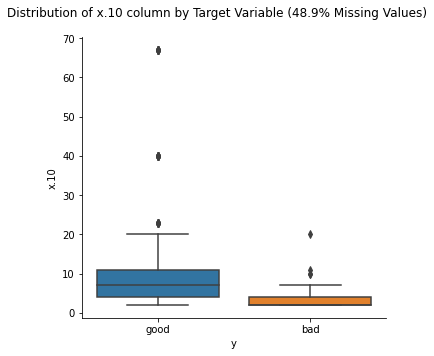

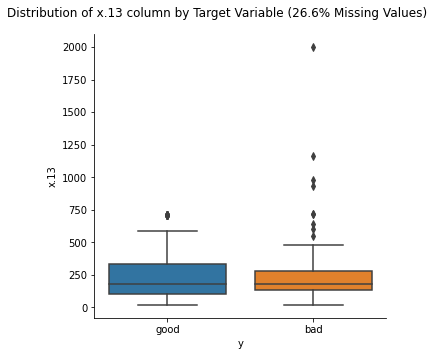

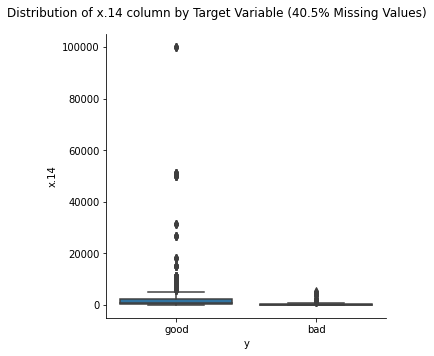

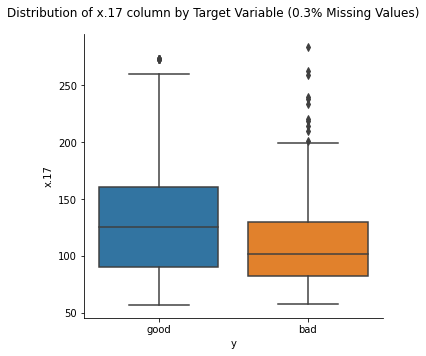

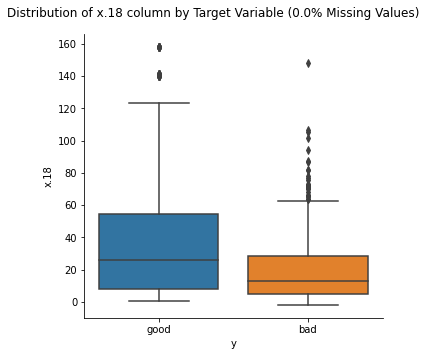

In [268]:
plot_box_col_by_target(df_train)

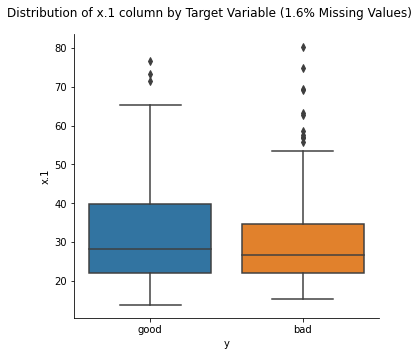

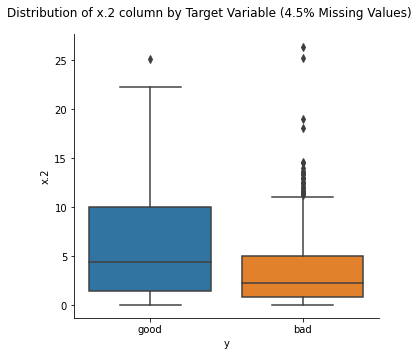

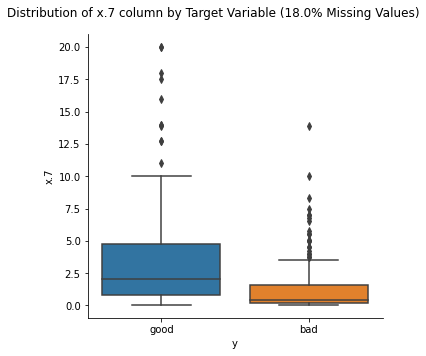

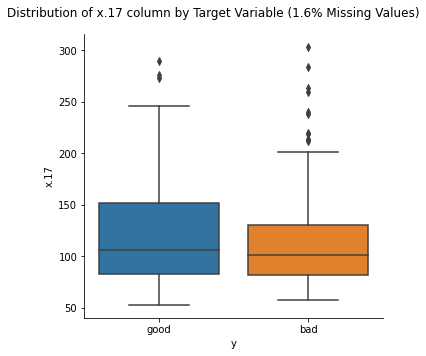

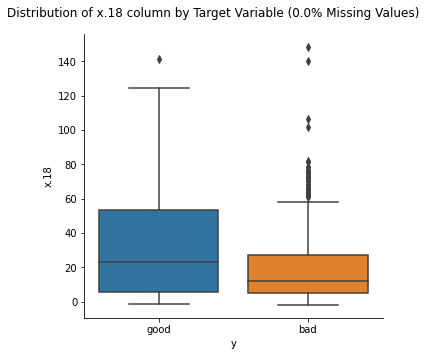

In [81]:
plot_box_col_by_target(df_val)

- distribution of all numerical columns seems to be similar in both training and validation dataset
- 'x.7' seem to have a skewed distribution [we will need to transform with MinMaxScaler or other scaler]

Conclusions:
- for all columns with missing values, we will fill NaN with mode or interpolated value
- we will scale numerical columns, as the majority show skewed distribution, as well as they all have very different value ranges
- we will explore correlation analysis to further understand whether to include all other columns in the model or not

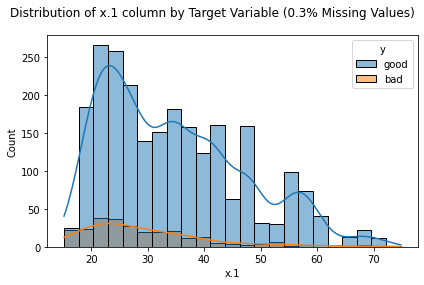

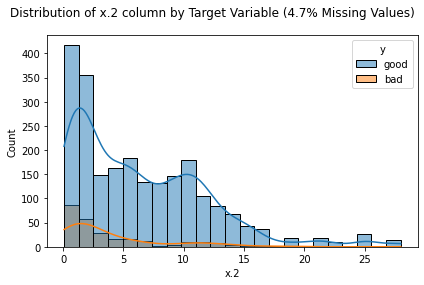

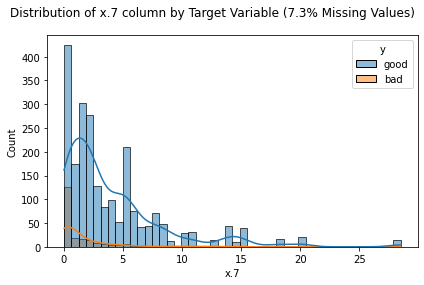

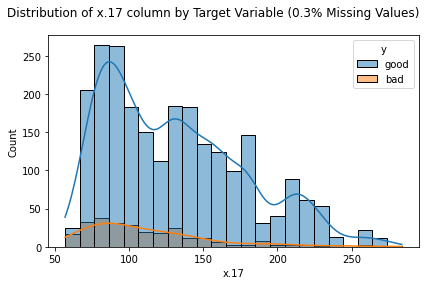

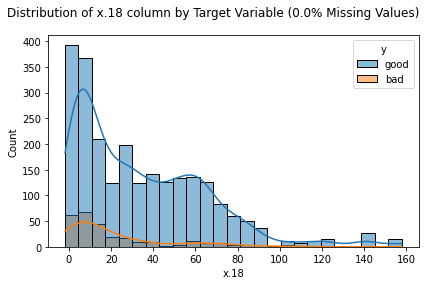

In [82]:
plot_hist_col_by_target(df_train)

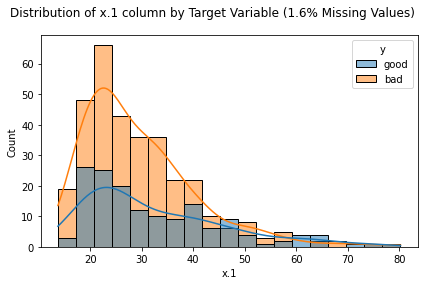

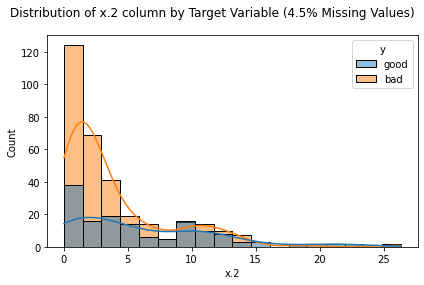

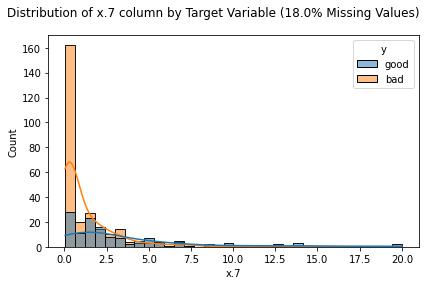

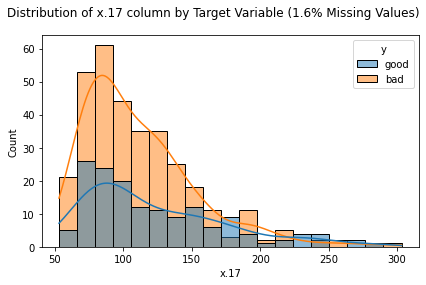

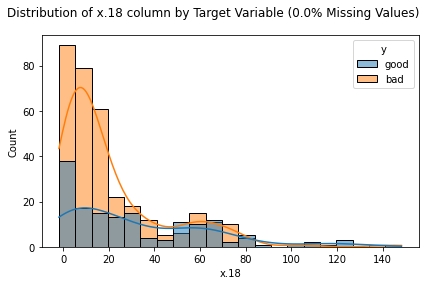

In [83]:
plot_hist_col_by_target(df_val)

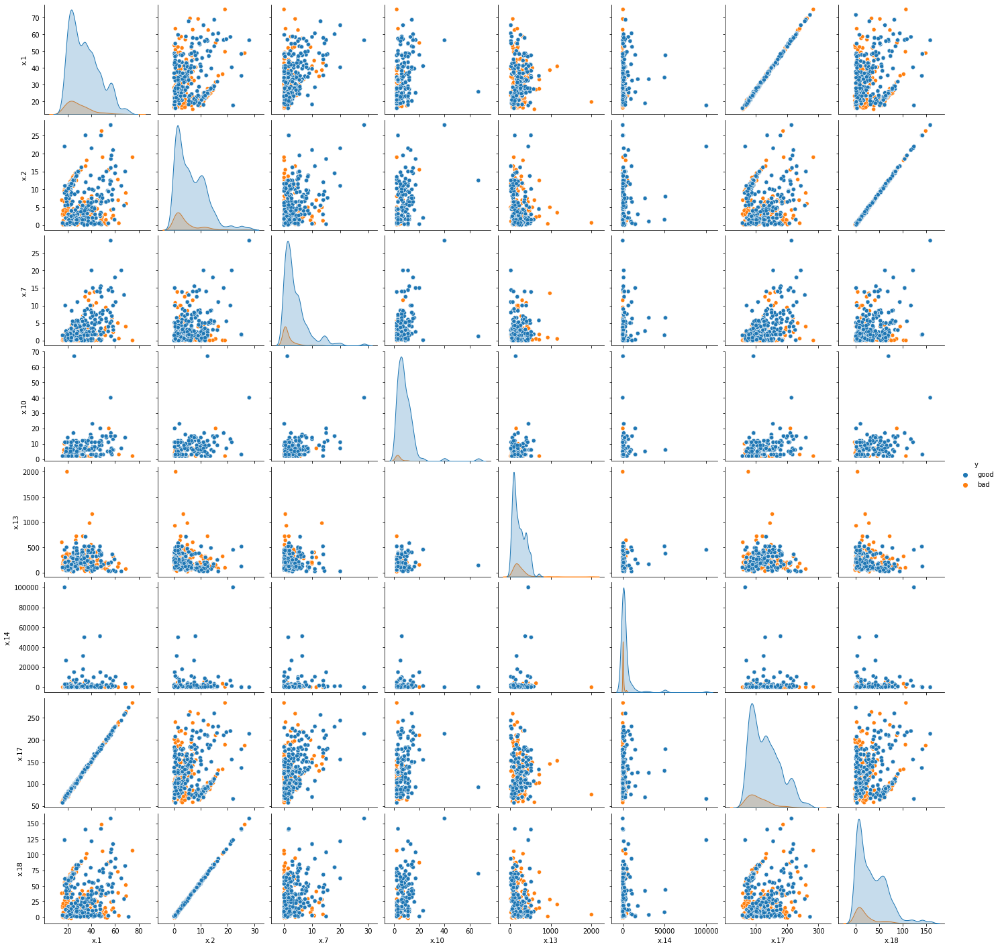

In [269]:
sns.pairplot(df_train[num_cols + ['y']], hue='y')

plt.show()

# Data Prep
In both Training and Validation Dataset (separatly) we will:
- Remove columns with > 25% missing values in Training Datset
- Fill Missing Values (Cat cols: mode, Num Cols: mode/median?/interpolation?)
- Label Encoding for Categorical Columns (one-hot encoding)
- Scale Numerical Columns (MinMaxScaler, StandardScaler)

## Remove Columns with >25% of Missing Values

In [270]:
nan_cols25 = [i for i in df_train.columns if df_train[i].isnull().sum() > 0.25*len(df_train)]

nan_cols25

['x.10', 'x.13', 'x.14', 'x.20', 'x.16']

In [273]:
#df_train = df_train.drop(columns=nan_cols25 + ['x.17', 'x.2'])
df_train = df_train.drop(columns=['x.17', 'x.2'])

df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.0     2656 non-null   object 
 1   x.1     2662 non-null   float64
 2   x.3     2647 non-null   object 
 3   x.5     2646 non-null   object 
 4   x.6     2646 non-null   object 
 5   x.7     2477 non-null   float64
 6   x.8     2671 non-null   object 
 7   x.9     2671 non-null   object 
 8   x.11    2671 non-null   object 
 9   x.12    2671 non-null   object 
 10  x.18    2671 non-null   float64
 11  y       2671 non-null   object 
dtypes: float64(3), object(9)
memory usage: 335.8+ KB


In [274]:
df_val = df_val.drop(columns=nan_cols25 + ['x.17', 'x.2'])

df_val.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 490 entries, 200 to 689
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.0     478 non-null    object 
 1   x.1     482 non-null    float64
 2   x.3     484 non-null    object 
 3   x.5     481 non-null    object 
 4   x.6     481 non-null    object 
 5   x.7     402 non-null    float64
 6   x.8     490 non-null    object 
 7   x.9     490 non-null    object 
 8   x.11    490 non-null    object 
 9   x.12    490 non-null    object 
 10  x.18    490 non-null    float64
 11  y       490 non-null    object 
dtypes: float64(3), object(9)
memory usage: 65.9+ KB


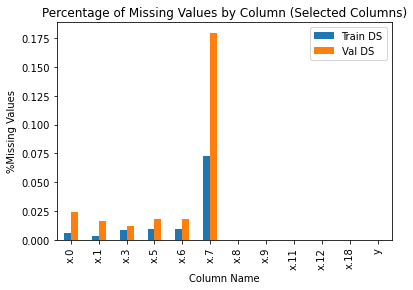

In [275]:
# Percentage of Missing Values by Columns

pd.concat([df_train.isnull().sum().div(len(df_train)), df_val.isnull().sum().div(len(df_val))], axis=1).plot(kind='bar')
plt.legend(['Train DS', 'Val DS'])
plt.title('Percentage of Missing Values by Column (Selected Columns)')
plt.xlabel('Column Name')
plt.ylabel('%Missing Values')
plt.show()

## Fill in Missing Values for remaining columns
Strategy: mode

In [276]:
df_train.describe()

,x.1,x.7,x.18
count,2662.000000,2477.000000,2671.000000
mean,34.162066,3.835440,33.181950
std,12.436797,4.404564,30.967519
min,15.170000,0.040000,-1.842044
25%,23.330000,0.835000,7.798115
50%,32.080000,2.460000,25.179497
75%,41.750000,5.085000,53.408285
max,74.830000,28.500000,157.888512


In [277]:
# Fill in Missing Values for Training Dataset
# Categorical Columns: fill NaN with mode
# Numerical Columns: fill NaN with mode

for col in df_train.columns.tolist():
    df_train[col].fillna(df_train[col].mode()[0], inplace=True)
    
#df_train.info()
df_train.describe()

,x.1,x.7,x.18
count,2671.000000,2671.000000,2671.000000
mean,34.125298,3.559770,33.181950
std,12.431917,4.354451,30.967519
min,15.170000,0.040000,-1.842044
25%,23.250000,0.500000,7.798115
50%,32.080000,2.040000,25.179497
75%,41.625000,5.000000,53.408285
max,74.830000,28.500000,157.888512


In [64]:
#plot_box_col_by_target(df_train)

In [63]:
#plot_cat_col_by_target(df_train)

In [278]:
df_val.describe()

,x.1,x.7,x.18
count,482.000000,402.000000,490.000000
mean,30.483610,2.000373,24.452660
std,11.950273,3.090601,27.037580
min,13.750000,0.040000,-1.842044
25%,21.920000,0.210000,4.931513
50%,27.085000,0.750000,14.303859
75%,36.290000,2.405000,34.288109
max,80.250000,20.000000,148.265741


In [279]:
# Fill in Missing Values for Validation Dataset
# Categorical Columns: fill NaN with mode
# Numerical Columns: fill NaN with mode

for col in df_val.columns.tolist():
    df_val[col].fillna(df_val[col].mode()[0], inplace=True)
    
#df_val.info()
df_val.describe()

,x.1,x.7,x.18
count,490.000000,490.000000,490.000000
mean,30.356041,1.686020,24.452660
std,11.893494,2.878405,27.037580
min,13.750000,0.040000,-1.842044
25%,21.940000,0.250000,4.931513
50%,26.750000,0.437500,14.303859
75%,36.170000,2.000000,34.288109
max,80.250000,20.000000,148.265741


In [67]:
#plot_box_col_by_target(df_val)

In [68]:
#plot_cat_col_by_target(df_val)

## Label Encoding for Categorical Variables & Scaling for Numerical Variables

Strategy:
- One-Hot Encoding for categorical variables with < 5 distinct values
- Label Encoding for categorical variables with >= 5 distinct values and Target variable
- StandardScaler Scaling for numerical variables

In [69]:
#from collections import Counter
#
#def cumulatively_categorise(column,threshold=0.75,return_categories_list=True):
#  #Find the threshold value using the percentage and number of instances in the column
#  threshold_value=int(threshold*len(column))
#  #Initialise an empty list for our new minimised categories
#  categories_list=[]
#  #Initialise a variable to calculate the sum of frequencies
#  s=0
#  #Create a counter dictionary of the form unique_value: frequency
#  counts=Counter(column)
#
#  #Loop through the category name and its corresponding frequency after sorting the categories by descending order of frequency
#  for i,j in counts.most_common():
#    #Add the frequency to the global sum
#    s+=dict(counts)[i]
#    #Append the category name to the list
#    categories_list.append(i)
#    #Check if the global sum has reached the threshold value, if so break the loop
#    if s>=threshold_value:
#      break
#  #Append the category Other to the list
#  categories_list.append('Other')
#
#  #Replace all instances not in our new categories by Other  
#  new_column=column.apply(lambda x: x if x in categories_list else 'Other')
#
#  #Return transformed column and unique values if return_categories=True
#  if(return_categories_list):
#    return new_column,categories_list
#  #Return only the transformed column if return_categories=False
#  else:
#    return new_column

In [321]:
#def cat_cols_encoding_old(df):
#    
#    ## One-Hot Encoder for categorical variables, excluding target
#    df_enc = pd.get_dummies(df, columns=cat_cols[:-1], drop_first=True)
#    
#    ## Label Encoding for Target Variable
#    le = preprocessing.LabelEncoder()
#    
#    print(df_enc['y'].value_counts())
#    le.fit(df_enc['y'])
#    print('Target Classes: ', list(le.classes_))
#    df_enc['y'] = le.transform(df_enc['y'])
#    print(df_enc['y'].value_counts())
#    
#    return df_enc

def cat_cols_encoding_old(df, oh_cols, l_cols, target_col, num_cols):
    '''
    - One-Hot Encoding for categorical variables with < 5 distinct values
    - Label Encoding for categorical variables with >= 5 distinct values and Target variable
    - StandardScaler Scaling for numerical variables
    '''
    
    ## One-Hot Encoder for categorical variables, excluding target
    df_enc = pd.get_dummies(df, columns=oh_cols, drop_first=True)
    
    ## Label Encoder for Specified Columns + Target
    for col in l_cols + target_col:
        le = preprocessing.LabelEncoder()
        
        #print(df_enc[col].value_counts())
        le.fit(df_enc[col])
        print('Classes: ', list(le.classes_))
        df_enc[col] = le.transform(df_enc[col])
        #print(df_enc[col].value_counts())
    
    
    mms = StandardScaler() #MinMaxScaler()
    mms.fit(df_enc[num_cols])
    df_enc[num_cols] = mms.transform(df_enc[num_cols])
        
    return df_enc

def cat_cols_encoding(df, oh_cols, target_col, num_cols):
    '''
    - One-Hot Encoding for categorical variables (previously cardinality was reduced by aggregating the less frequent values)
    - StandardScaler Scaling for numerical variables
    '''
    
    ## One-Hot Encoder for categorical variables, excluding target
    df_enc = pd.get_dummies(df, columns=oh_cols, drop_first=True)
    
    ## Label Encoder for Specified Columns + Target
    for col in target_col:
        le = preprocessing.LabelEncoder()
        
        #print(df_enc[col].value_counts())
        le.fit(df_enc[col])
        print('Classes: ', list(le.classes_))
        df_enc[col] = le.transform(df_enc[col])
        #print(df_enc[col].value_counts())
    
    
    ## Scaling of numerical columns
    mms = StandardScaler() #MinMaxScaler()
    #mms = MinMaxScaler()
    mms.fit(df_enc[num_cols])
    df_enc[num_cols] = mms.transform(df_enc[num_cols])
        
    return df_enc

In [322]:
cat_cols = df_train.select_dtypes(include=['object']).columns.tolist()
print('Cat Cols: ', cat_cols)

num_cols = df_train.select_dtypes(include=['float64']).columns.tolist()
print('Num Cols: ', num_cols)

Cat Cols:  ['x.0', 'x.3', 'x.5', 'x.6', 'x.8', 'x.9', 'x.11', 'x.12', 'y']
Num Cols:  ['x.1', 'x.7', 'x.18']


In [323]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.0     2671 non-null   object 
 1   x.1     2671 non-null   float64
 2   x.3     2671 non-null   object 
 3   x.5     2671 non-null   object 
 4   x.6     2671 non-null   object 
 5   x.7     2671 non-null   float64
 6   x.8     2671 non-null   object 
 7   x.9     2671 non-null   object 
 8   x.11    2671 non-null   object 
 9   x.12    2671 non-null   object 
 10  x.18    2671 non-null   float64
 11  y       2671 non-null   object 
dtypes: float64(3), object(9)
memory usage: 335.8+ KB


In [324]:
target_col = ['y']
#oh_cols = df_train.drop(columns=['x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new', 'y']).select_dtypes(include=['object']).columns.tolist()
oh_cols = df_train.drop(columns='y').select_dtypes(include=['object']).columns.tolist()
num_cols = df_train.select_dtypes(include=['float64']).columns.tolist()

print('One-Hot Encoded: ', oh_cols)
#print('Label Encoded: ', l_cols)
print('Target: ', target_col)
print('Standard Scaled: ', num_cols)

#df_train_enc = cat_cols_encoding(df_train, oh_cols[:-1], l_cols, target_col, num_cols)
#df_train_enc = cat_cols_encoding(df_train.drop(columns=['x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new']), 
#                                 oh_cols, target_col, num_cols)
df_train_enc = cat_cols_encoding(df_train, 
                                 oh_cols, target_col, num_cols)

df_train_enc.info()

One-Hot Encoded:  ['x.0', 'x.3', 'x.5', 'x.6', 'x.8', 'x.9', 'x.11', 'x.12']
Target:  ['y']
Standard Scaled:  ['x.1', 'x.7', 'x.18']
Classes:  ['bad', 'good']
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 35 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.1     2671 non-null   float64
 1   x.7     2671 non-null   float64
 2   x.18    2671 non-null   float64
 3   y       2671 non-null   int32  
 4   x.0_b   2671 non-null   uint8  
 5   x.3_u   2671 non-null   uint8  
 6   x.3_y   2671 non-null   uint8  
 7   x.5_c   2671 non-null   uint8  
 8   x.5_cc  2671 non-null   uint8  
 9   x.5_d   2671 non-null   uint8  
 10  x.5_e   2671 non-null   uint8  
 11  x.5_ff  2671 non-null   uint8  
 12  x.5_i   2671 non-null   uint8  
 13  x.5_j   2671 non-null   uint8  
 14  x.5_k   2671 non-null   uint8  
 15  x.5_m   2671 non-null   uint8  
 16  x.5_q   2671 non-null   uint8  
 17  x.5_r   2671 non-null   ui

In [325]:
df_train_enc.head()

,x.1,x.7,x.18,y,x.0_b,x.3_u,x.3_y,x.5_c,x.5_cc,x.5_d,x.5_e,x.5_ff,x.5_i,x.5_j,x.5_k,x.5_m,x.5_q,x.5_r,x.5_w,x.5_x,x.6_dd,x.6_ff,x.6_h,x.6_j,x.6_n,x.6_o,x.6_v,x.6_z,x.8_b,x.8_c,x.8_t,x.9_t,x.11_t,x.12_p,x.12_s
0,-0.265117,-0.530538,-1.053018,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0
1,1.974699,-0.119388,-0.251029,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0
2,-0.774386,-0.473115,-0.996864,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
3,-0.506477,0.043695,-0.811861,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,1,0,0
4,-1.122748,-0.424879,-0.066873,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1


In [98]:
#df_train_enc = cat_cols_encoding_old(df_train) 

#mask1 = ds_cat_stats_tr.column.isin(df_train.columns.tolist())
#mask2 = ds_cat_stats_tr.values_count_nona < 5
#oh_cols = ds_cat_stats_tr.loc[mask1 & mask2].column.unique().tolist()
#l_cols = ds_cat_stats_tr.loc[mask1 & ~mask2].column.unique().tolist()
target_col = ['y']
oh_cols = df_train.drop(columns=['x.5', 'x.6', 'x.10', 'x.13', 'x.14', 'y']).select_dtypes(include=['object']).columns.tolist()
num_cols = df_train.select_dtypes(include=['float64']).columns.tolist()

print('One-Hot Encoded: ', oh_cols)
#print('Label Encoded: ', l_cols)
print('Target: ', target_col)
print('Standard Scaled: ', num_cols)

#df_train_enc = cat_cols_encoding(df_train, oh_cols[:-1], l_cols, target_col, num_cols)
df_train_enc = cat_cols_encoding(df_train.drop(columns=['x.5', 'x.6', 'x.10', 'x.13', 'x.14']), 
                                 oh_cols, target_col, num_cols)

df_train_enc.info()

One-Hot Encoded:  ['x.0', 'x.3', 'x.8', 'x.9', 'x.11', 'x.12', 'x.20', 'x.16', 'x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new']
Target:  ['y']
Standard Scaled:  ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']
Classes:  ['bad', 'good']
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 79 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   x.1             2671 non-null   float64
 1   x.2             2671 non-null   float64
 2   x.7             2671 non-null   float64
 3   x.17            2671 non-null   float64
 4   x.18            2671 non-null   float64
 5   y               2671 non-null   int32  
 6   x.0_?           2671 non-null   uint8  
 7   x.0_a           2671 non-null   uint8  
 8   x.0_b           2671 non-null   uint8  
 9   x.3_?           2671 non-null   uint8  
 10  x.3_l           2671 non-null   uint8  
 11  x.3_u           2671 non-null   uint8  
 12  x.3_y           2671 non

In [185]:
df_train_enc

,x.1,x.2,x.7,x.17,x.18,y,x.0_?,x.0_a,x.0_b,x.3_?,x.3_l,x.3_u,x.3_y,x.5_?,x.5_aa,x.5_c,x.5_cc,x.5_d,x.5_e,x.5_ff,x.5_i,x.5_j,x.5_k,x.5_m,x.5_q,x.5_r,x.5_w,x.5_x,x.6_?,x.6_bb,x.6_dd,x.6_ff,x.6_h,x.6_j,x.6_n,x.6_o,x.6_v,x.6_z,x.8_a,x.8_b,x.8_c,x.8_t,x.9_f,x.9_t,x.10_10,x.10_11,x.10_12,x.10_13,x.10_14,x.10_15,x.10_16,x.10_17,x.10_2,x.10_20,x.10_23,x.10_3,x.10_4,x.10_40,x.10_5,x.10_6,x.10_67,x.10_7,x.10_8,x.10_9,x.10_f,x.10_t,x.11_f,x.11_t,x.12_g,x.12_p,x.12_s,x.13_100.0,x.13_102.0,x.13_108.0,x.13_110.0,x.13_112.0,x.13_1160.0,x.13_117.0,x.13_120.0,x.13_121.0,x.13_128.0,x.13_129.0,x.13_132.0,x.13_136.0,x.13_140.0,x.13_141.0,x.13_144.0,x.13_145.0,x.13_150.0,x.13_152.0,x.13_154.0,x.13_156.0,x.13_160.0,x.13_164.0,x.13_167.0,x.13_168.0,x.13_17.0,x.13_170.0,x.13_171.0,x.13_174.0,x.13_176.0,x.13_178.0,x.13_180.0,x.13_181.0,x.13_188.0,x.13_195.0,x.13_20.0,x.13_200.0,x.13_2000.0,x.13_202.0,x.13_204.0,x.13_21.0,x.13_210.0,x.13_211.0,x.13_212.0,x.13_216.0,x.13_22.0,x.13_220.0,x.13_221.0,x.13_225.0,x.13_228.0,x.13_230.0,x.13_232.0,x.13_239.0,x.13_24.0,x.13_240.0,x.13_250.0,x.13_253.0,x.13_254.0,x.13_260.0,x.13_263.0,x.13_268.0,x.13_272.0,x.13_274.0,x.13_276.0,x.13_28.0,x.13_280.0,x.13_288.0,x.13_29.0,x.13_292.0,x.13_30.0,x.13_300.0,x.13_311.0,x.13_320.0,x.13_329.0,x.13_333.0,x.13_340.0,x.13_348.0,x.13_350.0,x.13_352.0,x.13_356.0,x.13_360.0,x.13_368.0,x.13_370.0,x.13_372.0,x.13_375.0,x.13_380.0,x.13_381.0,x.13_393.0,x.13_395.0,x.13_396.0,x.13_399.0,x.13_40.0,x.13_400.0,x.13_408.0,x.13_410.0,x.13_411.0,x.13_420.0,x.13_43.0,x.13_431.0,x.13_434.0,x.13_440.0,x.13_443.0,x.13_45.0,x.13_450.0,x.13_454.0,x.13_455.0,x.13_460.0,x.13_470.0,x.13_480.0,x.13_487.0,x.13_49.0,x.13_491.0,x.13_50.0,x.13_500.0,x.13_510.0,x.13_515.0,x.13_519.0,x.13_52.0,x.13_520.0,x.13_550.0,x.13_56.0,x.13_583.0,x.13_60.0,x.13_600.0,x.13_62.0,x.13_640.0,x.13_70.0,x.13_711.0,x.13_720.0,x.13_73.0,x.13_75.0,x.13_80.0,x.13_86.0,x.13_88.0,x.13_92.0,x.13_928.0,x.13_93.0,x.13_94.0,x.13_96.0,x.13_980.0,x.13_?,x.13_f,x.14_10,x.14_100,x.14_1000,x.14_10000,x.14_100000,x.14_1004,x.14_105,x.14_10561,x.14_1058,x.14_1062,x.14_1065,x.14_11,x.14_1110,x.14_11177,x.14_112,x.14_11202,x.14_113,x.14_1187,x.14_12,x.14_120,x.14_1200,x.14_1208,x.14_1210,x.14_1212,x.14_122,x.14_1236,x.14_126,x.14_1260,x.14_1270,x.14_13,x.14_130,x.14_1300,x.14_1332,x.14_1349,x.14_14,x.14_140,x.14_1430,x.14_1442,x.14_146,x.14_147,x.14_15,x.14_150,x.14_15000,x.14_15108,x.14_158,x.14_16,x.14_1602,x.14_1655,x.14_168,x.14_17,x.14_1704,x.14_173,x.14_179,x.14_18,x.14_18027,x.14_184,x.14_19,x.14_195,x.14_1950,x.14_196,x.14_2,x.14_20,x.14_200,x.14_2000,x.14_2010,x.14_2028,x.14_204,x.14_2072,x.14_21,x.14_210,x.14_2100,x.14_2184,x.14_22,x.14_2200,x.14_221,x.14_225,x.14_228,x.14_2283,x.14_2300,x.14_245,x.14_247,x.14_25,x.14_2503,x.14_251,x.14_2510,x.14_258,x.14_26726,x.14_2690,x.14_27,x.14_2732,x.14_278,x.14_2803,x.14_284,x.14_286,x.14_2954,x.14_3,x.14_300,x.14_3000,x.14_3065,x.14_31285,x.14_314,x.14_316,x.14_32,x.14_3257,x.14_33,x.14_3376,x.14_35,x.14_350,x.14_351,x.14_3552,x.14_367,x.14_375,x.14_38,x.14_396,x.14_4,x.14_40,x.14_400,x.14_4000,x.14_41,x.14_42,x.14_4208,x.14_44,x.14_444,x.14_4500,x.14_456,x.14_475,x.14_484,x.14_5,x.14_50,x.14_500,x.14_5000,x.14_50000,x.14_51100,x.14_5200,x.14_53,x.14_540,x.14_55,x.14_551,x.14_5552,x.14_560,x.14_567,x.14_5800,x.14_582,x.14_6,x.14_60,x.14_600,x.14_610,x.14_639,x.14_6590,x.14_67,x.14_6700,x.14_678,x.14_687,x.14_7,x.14_70,x.14_7059,x.14_713,x.14_722,x.14_730,x.14_742,x.14_7544,x.14_769,x.14_790,x.14_8,x.14_80,x.14_809,x.14_824,x.14_827,x.14_837,x.14_857,x.14_87,x.14_8851,x.14_892,x.14_98,x.14_9800,x.14_99,x.14_f,x.14_t,x.20_?,x.20_f,x.20_t,x.16_?,x.16_f,x.16_t
0,0.262487,0.229943,0.042516,0.264224,0.015155,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [326]:
df_train_enc.describe()[num_cols].round(3)

,x.1,x.7,x.18
count,2671.000,2671.000,2671.000
mean,-0.000,-0.000,0.000
std,1.000,1.000,1.000
min,-1.525,-0.808,-1.131
25%,-0.875,-0.703,-0.820
50%,-0.165,-0.349,-0.258
75%,0.603,0.331,0.653
max,3.275,5.729,4.028


In [327]:
df_train.describe().round(3)

,x.1,x.7,x.18
count,2671.000,2671.000,2671.000
mean,34.125,3.560,33.182
std,12.432,4.354,30.968
min,15.170,0.040,-1.842
25%,23.250,0.500,7.798
50%,32.080,2.040,25.179
75%,41.625,5.000,53.408
max,74.830,28.500,157.889


In [553]:
#plot_box_col_by_target(df_train_enc)

In [328]:
print('One-Hot Encoded: ', oh_cols)
print('Target: ', target_col)
print('Standard Scaled: ', num_cols)

#df_val_enc = cat_cols_encoding(df_val.drop(columns=['x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new']), 
#                                 oh_cols, target_col, num_cols)
df_val_enc = cat_cols_encoding(df_val, 
                                 oh_cols, target_col, num_cols)

df_val_enc.info()

One-Hot Encoded:  ['x.0', 'x.3', 'x.5', 'x.6', 'x.8', 'x.9', 'x.11', 'x.12']
Target:  ['y']
Standard Scaled:  ['x.1', 'x.7', 'x.18']
Classes:  ['bad', 'good']
<class 'pandas.core.frame.DataFrame'>
Int64Index: 490 entries, 200 to 689
Data columns (total 35 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.1     490 non-null    float64
 1   x.7     490 non-null    float64
 2   x.18    490 non-null    float64
 3   y       490 non-null    int32  
 4   x.0_b   490 non-null    uint8  
 5   x.3_u   490 non-null    uint8  
 6   x.3_y   490 non-null    uint8  
 7   x.5_c   490 non-null    uint8  
 8   x.5_cc  490 non-null    uint8  
 9   x.5_d   490 non-null    uint8  
 10  x.5_e   490 non-null    uint8  
 11  x.5_ff  490 non-null    uint8  
 12  x.5_i   490 non-null    uint8  
 13  x.5_j   490 non-null    uint8  
 14  x.5_k   490 non-null    uint8  
 15  x.5_m   490 non-null    uint8  
 16  x.5_q   490 non-null    uint8  
 17  x.5_r   490 non-null    ui

In [102]:
print('One-Hot Encoded: ', oh_cols)
print('Target: ', target_col)
print('MinMax Scaled: ', num_cols)

df_val_enc = cat_cols_encoding(df_val.drop(columns=['x.5', 'x.6', 'x.10', 'x.13', 'x.14']), 
                                 oh_cols, target_col, num_cols)

df_val_enc.info()

One-Hot Encoded:  ['x.0', 'x.3', 'x.8', 'x.9', 'x.11', 'x.12', 'x.20', 'x.16', 'x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new']
Target:  ['y']
MinMax Scaled:  ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']
Classes:  ['bad', 'good']
<class 'pandas.core.frame.DataFrame'>
Int64Index: 490 entries, 200 to 689
Data columns (total 70 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   x.1             490 non-null    float64
 1   x.2             490 non-null    float64
 2   x.7             490 non-null    float64
 3   x.17            490 non-null    float64
 4   x.18            490 non-null    float64
 5   y               490 non-null    int32  
 6   x.0_?           490 non-null    uint8  
 7   x.0_a           490 non-null    uint8  
 8   x.0_b           490 non-null    uint8  
 9   x.3_?           490 non-null    uint8  
 10  x.3_l           490 non-null    uint8  
 11  x.3_u           490 non-null    uint8  
 12  x.3_y           490 non-nu

In [103]:
##mask1 = ds_cat_stats_val.column.isin(df_val.columns.tolist())
##mask2 = ds_cat_stats_val.values_count_nona < 5
##oh_cols = ds_cat_stats_val.loc[mask1 & mask2].column.unique().tolist()
##l_cols = ds_cat_stats_val.loc[mask1 & ~mask2].column.unique().tolist()
##target_col = ['y']
##num_cols = df_val.select_dtypes(include=['float64']).columns.tolist()
#
#print('One-Hot Encoded: ', oh_cols[:-1])
#print('Label Encoded: ', l_cols)
#print('Target: ', target_col)
#print('Standard Scaled: ', num_cols)
#
#df_val_enc = cat_cols_encoding(df_val, oh_cols[:-1], l_cols, target_col, num_cols)
#
#df_val_enc.info()

In [329]:
df_val_enc.head()

,x.1,x.7,x.18,y,x.0_b,x.3_u,x.3_y,x.5_c,x.5_cc,x.5_d,x.5_e,x.5_ff,x.5_i,x.5_j,x.5_k,x.5_m,x.5_q,x.5_r,x.5_w,x.5_x,x.6_dd,x.6_ff,x.6_h,x.6_j,x.6_n,x.6_o,x.6_v,x.6_z,x.8_b,x.8_c,x.8_t,x.9_t,x.11_t,x.12_p,x.12_s
200,-0.528226,-0.151635,-0.784462,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0
201,0.923629,0.196135,-0.731136,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0
202,-0.465102,0.196135,-0.276279,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0
203,-0.808497,-0.339430,1.281836,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,0,0
204,0.502801,-0.556786,-0.495206,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0


In [330]:
df_val_enc[num_cols].describe().round(3)

,x.1,x.7,x.18
count,490.000,490.000,490.000
mean,0.000,0.000,0.000
std,1.001,1.001,1.001
min,-1.398,-0.572,-0.974
25%,-0.708,-0.499,-0.723
50%,-0.304,-0.434,-0.376
75%,0.489,0.109,0.364
max,4.199,6.369,4.584


In [331]:
df_val.describe().round(3)

,x.1,x.7,x.18
count,490.000,490.000,490.000
mean,30.356,1.686,24.453
std,11.893,2.878,27.038
min,13.750,0.040,-1.842
25%,21.940,0.250,4.932
50%,26.750,0.438,14.304
75%,36.170,2.000,34.288
max,80.250,20.000,148.266


In [332]:
df_train_enc.y.value_counts()

1    2398
0     273
Name: y, dtype: int64

In [333]:
df_val_enc.y.value_counts()

0    336
1    154
Name: y, dtype: int64

In [334]:
print('Training Data Shape: ', df_train_enc.shape)
print('Validation Data Shape: ', df_val_enc.shape)

Training Data Shape:  (2671, 35)
Validation Data Shape:  (490, 35)


In [62]:
#X = df_train.drop('y',axis=1)
#y = df_train['y']
#
#pipeline = ColumnTransformer([
#    #("num_scaler",StandardScaler(),num_cols),
#    ("num_scaler",MinMaxScaler(),num_cols),
#    ("encoder",OneHotEncoder(),oh_cols[:-1]), 
#    #("label_encoder",LabelEncoder(),l_cols)
#])
#
#X = pipeline.fit_transform(X)
#
#print(X.shape)
#print(y.shape)
#
### Label Encoding for Target Variable
#le = LabelEncoder()
#
##print(y.value_counts())
#le.fit(y)
#print('Target Classes: ', list(le.classes_))
#y = le.transform(y)
##print(y.value_counts())
#
#
#X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.15,random_state=42)

In [63]:
#X_val = df_val.drop('y',axis=1)
#y_val = df_val['y']
#
#pipeline = ColumnTransformer([
#    #("num_scaler",StandardScaler(),num_cols),
#    ("num_scaler",MinMaxScaler(),num_cols),
#    ("encoder",OneHotEncoder(),oh_cols[:-1])
#])
#
#X_val = pipeline.fit_transform(X_val)
#
#print(X_val.shape)
#print(y_val.shape)
#
### Label Encoding for Target Variable
#le = LabelEncoder()
#
##print(y.value_counts())
#le.fit(y_val)
#print('Target Classes: ', list(le.classes_))
#y_val = le.transform(y_val)
##print(y.value_counts())

# Correlation Analysis

In [114]:
#dfT = df_train_enc.drop(columns='y')
#y = df_train_enc['y']
#
#dfT.columns

In [115]:
#dfT

In [335]:
df_train_enc.columns

Index(['x.1', 'x.7', 'x.18', 'y', 'x.0_b', 'x.3_u', 'x.3_y', 'x.5_c', 'x.5_cc', 'x.5_d', 'x.5_e', 'x.5_ff', 'x.5_i', 'x.5_j', 'x.5_k', 'x.5_m', 'x.5_q', 'x.5_r', 'x.5_w', 'x.5_x', 'x.6_dd', 'x.6_ff', 'x.6_h', 'x.6_j', 'x.6_n', 'x.6_o', 'x.6_v', 'x.6_z', 'x.8_b', 'x.8_c', 'x.8_t', 'x.9_t', 'x.11_t', 'x.12_p', 'x.12_s'], dtype='object')

In [336]:
# Correlation Matrix with names
columns = df_train_enc.columns
correlations = df_train_enc.corr()
#print (correlations)

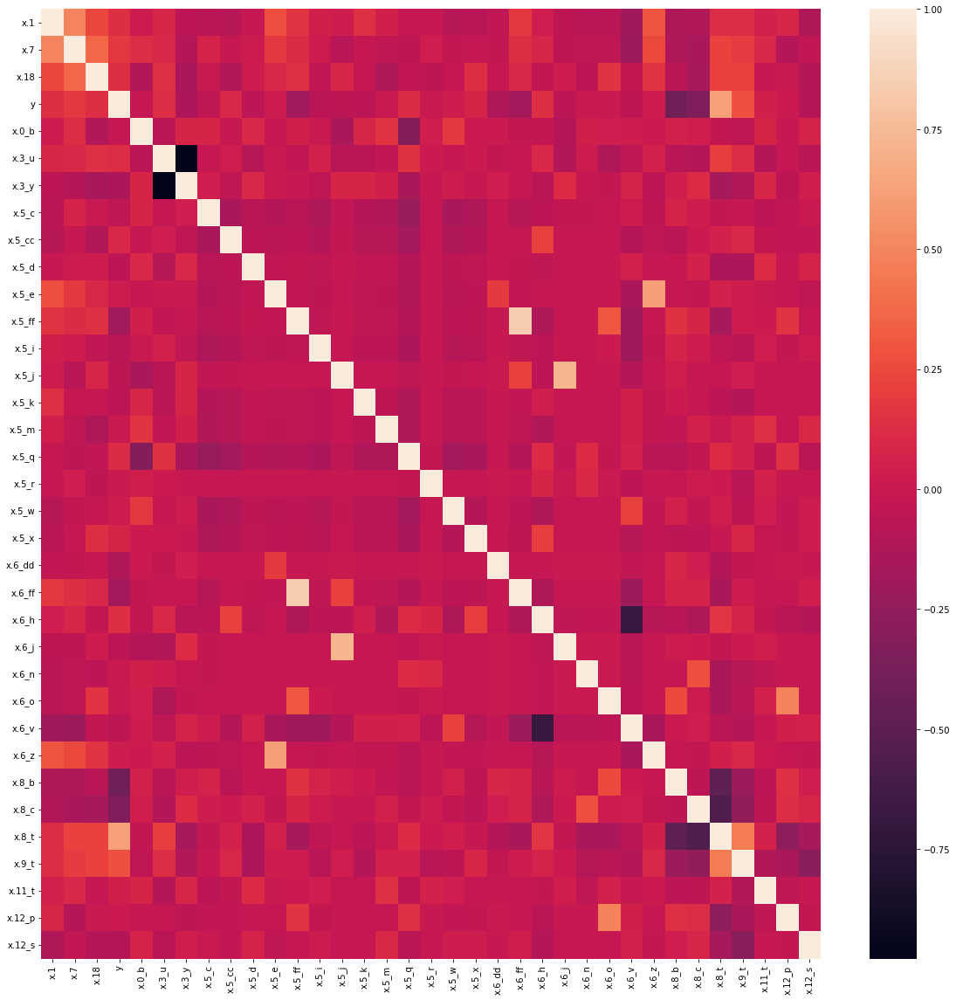

In [337]:
plt.figure(figsize=(20, 20))

sns.heatmap(correlations)

plt.show()

C:\Users\ITMOND~1\AppData\Local\Temp/ipykernel_25632/118324412.py:1: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper_tri = correlations.abs().where(np.triu(np.ones(correlations.shape),k=1).astype(np.bool))


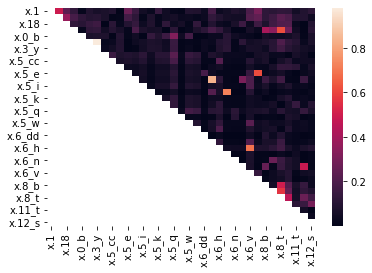

In [349]:
upper_tri = correlations.abs().where(np.triu(np.ones(correlations.shape),k=1).astype(np.bool))
#print(upper_tri)

sns.heatmap(upper_tri)

plt.show()

In [352]:
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.7)]
print(); print(to_drop)


['x.3_y', 'x.6_ff', 'x.6_j']


In [338]:
#Correlation with output variable
cor_target = abs(correlations["y"])

#Selecting highly correlated features
relevant_features = cor_target[cor_target > 0.10]
relevant_features

x.1       0.129895
x.7       0.180206
x.18      0.127240
y         1.000000
x.3_u     0.121702
x.3_y     0.129101
x.5_ff    0.185269
x.5_q     0.114002
x.6_dd    0.114779
x.6_ff    0.180518
x.6_h     0.133792
x.8_b     0.407145
x.8_c     0.341299
x.8_t     0.617057
x.9_t     0.277536
x.12_s    0.104845
Name: y, dtype: float64

In [339]:
relevant_features_list = relevant_features.index.tolist()

relevant_features_list

['x.1',
 'x.7',
 'x.18',
 'y',
 'x.3_u',
 'x.3_y',
 'x.5_ff',
 'x.5_q',
 'x.6_dd',
 'x.6_ff',
 'x.6_h',
 'x.8_b',
 'x.8_c',
 'x.8_t',
 'x.9_t',
 'x.12_s']

In [301]:
correlations[["x.1", "x.2", "x.7", "x.17", "x.18", "y"]]

KeyError: "['x.2', 'x.17'] not in index"

# CatBoost

In [95]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 24 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   x.0       2671 non-null   object 
 1   x.1       2671 non-null   float64
 2   x.2       2671 non-null   float64
 3   x.3       2671 non-null   object 
 4   x.5       2671 non-null   object 
 5   x.6       2671 non-null   object 
 6   x.7       2671 non-null   float64
 7   x.8       2671 non-null   object 
 8   x.9       2671 non-null   object 
 9   x.10      2671 non-null   object 
 10  x.11      2671 non-null   object 
 11  x.12      2671 non-null   object 
 12  x.13      2671 non-null   object 
 13  x.14      2671 non-null   object 
 14  x.20      2671 non-null   object 
 15  x.17      2671 non-null   float64
 16  x.18      2671 non-null   float64
 17  x.16      2671 non-null   object 
 18  y         2671 non-null   object 
 19  x.5_new   2671 non-null   object 
 20  x.6_new   2671 non-null   obje

In [96]:
df_train.head()

,x.0,x.1,x.2,x.3,x.5,x.6,x.7,x.8,x.9,x.10,x.11,x.12,x.13,x.14,x.20,x.17,x.18,x.16,y,x.5_new,x.6_new,x.10_new,x.13_new,x.14_new
0,b,30.83,6.500,u,w,v,1.25,t,t,t,f,g,202.0,f,t,116.942570,0.578709,f,good,w,v,t,Other,f
1,a,58.67,4.460,u,q,h,3.04,t,t,6,f,g,43.0,560,t,225.606253,25.409645,f,good,q,h,6,Other,560
2,a,24.50,0.500,u,q,h,1.50,t,f,f,f,g,280.0,824,t,92.084077,2.317337,f,good,q,h,f,280.0,824
3,b,27.83,1.540,u,w,v,3.75,t,t,5,t,g,100.0,3,t,104.162918,8.045338,f,good,w,v,Other,100.0,3
4,b,20.17,5.625,u,w,v,1.71,t,f,f,f,s,120.0,f,t,77.870302,31.111461,f,good,w,v,f,120.0,f


In [97]:
df_val.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 490 entries, 200 to 689
Data columns (total 24 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   x.0       490 non-null    object 
 1   x.1       490 non-null    float64
 2   x.2       490 non-null    float64
 3   x.3       490 non-null    object 
 4   x.5       490 non-null    object 
 5   x.6       490 non-null    object 
 6   x.7       490 non-null    float64
 7   x.8       490 non-null    object 
 8   x.9       490 non-null    object 
 9   x.10      490 non-null    object 
 10  x.11      490 non-null    object 
 11  x.12      490 non-null    object 
 12  x.13      490 non-null    object 
 13  x.14      490 non-null    object 
 14  x.20      490 non-null    object 
 15  x.17      490 non-null    float64
 16  x.18      490 non-null    float64
 17  x.16      490 non-null    object 
 18  y         490 non-null    object 
 19  x.5_new   490 non-null    object 
 20  x.6_new   490 non-null    obje

In [98]:
print(df_train['y'].value_counts())
df_train['y'] = df_train['y'].map({'good':1, 'bad':0})
print(df_train['y'].value_counts())

good    2398
bad      273
Name: y, dtype: int64
1    2398
0     273
Name: y, dtype: int64


In [99]:
print(df_val['y'].value_counts())
df_val['y'] = df_val['y'].map({'good':1, 'bad':0})
print(df_val['y'].value_counts())

bad     336
good    154
Name: y, dtype: int64
0    336
1    154
Name: y, dtype: int64


In [104]:
y = df_train.y
X = df_train.drop(['y', 'x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new'], axis=1)

#X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.15,random_state=42
                                                    
X.shape

(2671, 18)

In [117]:
def scale_num_cols(X, scaler):
    
    num_cols = X.select_dtypes(include=['float64']).columns.tolist()
    print('Num Cols: ', num_cols)
    
    # Scale Numerical Features
    #ss = StandardScaler() 
    #ss = MinMaxScaler()
    scaler.fit(X[num_cols])
    X[num_cols] = scaler.transform(X[num_cols])
    
    return X

In [129]:
scaler = MinMaxScaler()
scaler = StandardScaler()
X = scale_num_cols(X, scaler)
X.describe()

Num Cols:  ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']


,x.1,x.2,x.7,x.17,x.18
count,2.671000e+03,2.671000e+03,2.671000e+03,2.671000e+03,2.671000e+03
mean,-3.192255e-17,1.064085e-16,-5.320425e-18,-5.320425e-18,-1.675934e-16
std,1.000187e+00,1.000187e+00,1.000187e+00,1.000187e+00,1.000187e+00
min,-1.525014e+00,-1.135934e+00,-8.084668e-01,-1.532346e+00,-1.131203e+00
25%,-8.749523e-01,-8.331823e-01,-7.028080e-01,-8.485017e-01,-8.198457e-01
50%,-1.645507e-01,-2.221076e-01,-3.490806e-01,-1.224358e-01,-2.584628e-01
75%,6.033749e-01,6.211382e-01,3.308110e-01,6.151146e-01,6.532691e-01
max,3.274823e+00,4.049843e+00,5.728599e+00,3.281882e+00,4.027766e+00


In [120]:
#num_cols = X.select_dtypes(include=['float64']).columns.tolist()
#print('Num Cols: ', num_cols)
#
## Scale Numerical Features
##ss = StandardScaler() 
#ss = MinMaxScaler()
#ss.fit(X[num_cols])
#X[num_cols] = ss.transform(X[num_cols])
#
#X.describe()

In [105]:
y_val = df_val.y
X_val = df_val.drop(['y', 'x.5_new', 'x.6_new', 'x.10_new', 'x.13_new', 'x.14_new'], axis=1)
X_val.shape

(490, 18)

In [130]:
X_val = scale_num_cols(X_val, scaler)
X_val.describe()

Num Cols:  ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']


,x.1,x.2,x.7,x.17,x.18
count,4.900000e+02,4.900000e+02,4.900000e+02,4.900000e+02,4.900000e+02
mean,1.341331e-16,-8.519262e-17,1.268826e-16,5.075305e-17,-6.344132e-17
std,1.001022e+00,1.001022e+00,1.001022e+00,1.001022e+00,1.001022e+00
min,-1.397656e+00,-9.369523e-01,-5.724360e-01,-1.345264e+00,-9.735182e-01
25%,-7.083404e-01,-7.158914e-01,-4.994043e-01,-7.176181e-01,-7.227384e-01
50%,-3.035043e-01,-3.414627e-01,-4.341975e-01,-2.787505e-01,-3.757427e-01
75%,4.893348e-01,3.500139e-01,1.091926e-01,4.779323e-01,3.641414e-01
max,4.199350e+00,4.625534e+00,6.369046e+00,4.152255e+00,4.583976e+00


In [131]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2671 entries, 0 to 2670
Data columns (total 18 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x.0     2671 non-null   object 
 1   x.1     2671 non-null   float64
 2   x.2     2671 non-null   float64
 3   x.3     2671 non-null   object 
 4   x.5     2671 non-null   object 
 5   x.6     2671 non-null   object 
 6   x.7     2671 non-null   float64
 7   x.8     2671 non-null   object 
 8   x.9     2671 non-null   object 
 9   x.10    2671 non-null   object 
 10  x.11    2671 non-null   object 
 11  x.12    2671 non-null   object 
 12  x.13    2671 non-null   object 
 13  x.14    2671 non-null   object 
 14  x.20    2671 non-null   object 
 15  x.17    2671 non-null   float64
 16  x.18    2671 non-null   float64
 17  x.16    2671 non-null   object 
dtypes: float64(5), object(13)
memory usage: 461.0+ KB


In [132]:
cat_features = X.select_dtypes(include=['object']).columns.tolist()
print('Cat Features: ', cat_features)

num_cols = X.select_dtypes(include=['float64']).columns.tolist()
print('Num Cols: ', num_cols)

Cat Features:  ['x.0', 'x.3', 'x.5', 'x.6', 'x.8', 'x.9', 'x.10', 'x.11', 'x.12', 'x.13', 'x.14', 'x.20', 'x.16']
Num Cols:  ['x.1', 'x.2', 'x.7', 'x.17', 'x.18']


In [133]:
pool1 = Pool(data=X, label=y, cat_features=cat_features)

print('dataset 1:' + str(pool1.shape))

print('Column names')
print('dataset 1:')
print(pool1.get_feature_names()) 

dataset 1:(2671, 18)
Column names
dataset 1:
['x.0', 'x.1', 'x.2', 'x.3', 'x.5', 'x.6', 'x.7', 'x.8', 'x.9', 'x.10', 'x.11', 'x.12', 'x.13', 'x.14', 'x.20', 'x.17', 'x.18', 'x.16']


In [137]:
model = CatBoostClassifier(
    iterations=15,
#     verbose=5,
)
model.fit(
    X, y,
    cat_features=cat_features,
    eval_set=(X_val, y_val),
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.251014
0:	learn: 0.4937782	test: 0.6219885	best: 0.6219885 (0)	total: 31.8ms	remaining: 446ms
1:	learn: 0.3612225	test: 0.6279295	best: 0.6219885 (0)	total: 66ms	remaining: 429ms
2:	learn: 0.2742916	test: 0.6399507	best: 0.6219885 (0)	total: 100ms	remaining: 401ms
3:	learn: 0.2129079	test: 0.6293518	best: 0.6219885 (0)	total: 121ms	remaining: 333ms
4:	learn: 0.1711575	test: 0.6904738	best: 0.6219885 (0)	total: 133ms	remaining: 266ms
5:	learn: 0.1384475	test: 0.7203401	best: 0.6219885 (0)	total: 167ms	remaining: 251ms
6:	learn: 0.1125307	test: 0.7555217	best: 0.6219885 (0)	total: 201ms	remaining: 229ms
7:	learn: 0.0920544	test: 0.7842799	best: 0.6219885 (0)	total: 232ms	remaining: 203ms
8:	learn: 0.0782767	test: 0.7995509	best: 0.6219885 (0)	total: 265ms	remaining: 177ms
9:	learn: 0.0657239	test: 0.8611246	best: 0.6219885 (0)	total: 286ms	remaining: 143ms
10:	learn: 0.0563073	test: 0.8973413	best: 0.6219885 (0)	total: 319ms	remaining: 116ms
11:	learn: 0.0483680	te

In [135]:
from catboost.utils import get_roc_curve
import sklearn
from sklearn import metrics

eval_pool = Pool(X_val, y_val, cat_features=cat_features)
curve = get_roc_curve(model, eval_pool)
(fpr, tpr, thresholds) = curve
roc_auc = sklearn.metrics.auc(fpr, tpr)

roc_auc

0.7852408008658008

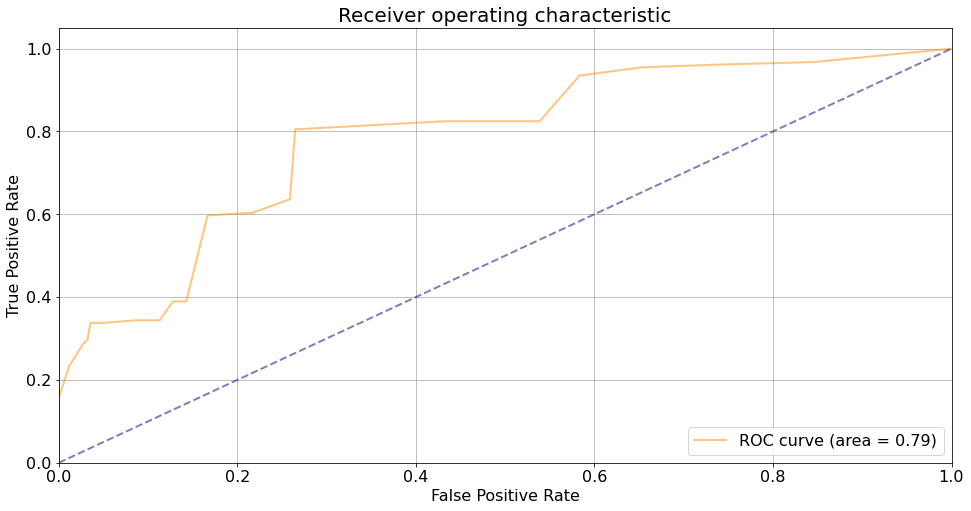

In [136]:
plt.figure(figsize=(16, 8))
lw = 2

plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc, alpha=0.5)

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('False Positive Rate', fontsize=16)
plt.ylabel('True Positive Rate', fontsize=16)
plt.title('Receiver operating characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize=16)
plt.show()

# Model Competition

In [340]:
#relevant_features_list.remove('x.20_?')

relevant_features_list

['x.1',
 'x.7',
 'x.18',
 'y',
 'x.3_u',
 'x.3_y',
 'x.5_ff',
 'x.5_q',
 'x.6_dd',
 'x.6_ff',
 'x.6_h',
 'x.8_b',
 'x.8_c',
 'x.8_t',
 'x.9_t',
 'x.12_s']

In [341]:
dfT = df_train_enc[relevant_features_list]
dfV = df_val_enc[relevant_features_list]
dfT.head()

,x.1,x.7,x.18,y,x.3_u,x.3_y,x.5_ff,x.5_q,x.6_dd,x.6_ff,x.6_h,x.8_b,x.8_c,x.8_t,x.9_t,x.12_s
0,-0.265117,-0.530538,-1.053018,1,1,0,0,0,0,0,0,0,0,1,1,0
1,1.974699,-0.119388,-0.251029,1,1,0,0,1,0,0,1,0,0,1,1,0
2,-0.774386,-0.473115,-0.996864,1,1,0,0,1,0,0,1,0,0,1,0,0
3,-0.506477,0.043695,-0.811861,1,1,0,0,0,0,0,0,0,0,1,1,0
4,-1.122748,-0.424879,-0.066873,1,1,0,0,0,0,0,0,0,0,1,0,1


In [342]:
print(dfT.shape)
print(dfV.shape)

(2671, 16)
(490, 16)


In [236]:
#!pip install imblearn

In [311]:
from imblearn.under_sampling import NearMiss

# summarize class distribution
counter = Counter(dfT['y'])
print(counter)
# define the undersampling method
undersample = NearMiss(version=1, n_neighbors=3)
# transform the dataset
X, y = undersample.fit_resample(dfT.drop(columns='y'), dfT['y'])
# summarize the new class distribution
counter = Counter(y)
print(counter)

Counter({1: 2398, 0: 273})
Counter({0: 273, 1: 273})


In [312]:
#X = df_train_enc.drop(columns='y')
#y = df_train_enc['y']

#X = dfT.drop(columns='y')
#y = dfT['y']

#X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.15,random_state=42)

#X_val = df_val_enc.drop(columns='y')
#y_val = df_val_enc['y']

X_val = dfV.drop(columns='y')
y_val = dfV['y']

In [313]:
#y_train.value_counts(normalize=True)
y.value_counts(normalize=True)

0    0.5
1    0.5
Name: y, dtype: float64

In [314]:
#y_test.value_counts(normalize=True)

In [315]:
y_val.value_counts(normalize=True)

0    0.685714
1    0.314286
Name: y, dtype: float64

Training LogisticRegression()
Score Val: 0.7183673469387755
F1-Score Val: 0.39473684210526316


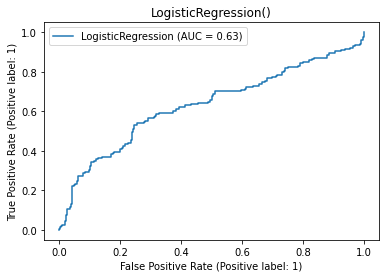

Training MLPClassifier(random_state=42)
Score Val: 0.7163265306122449
F1-Score Val: 0.2871794871794872


C:\Users\ITMONDINOC\Miniconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


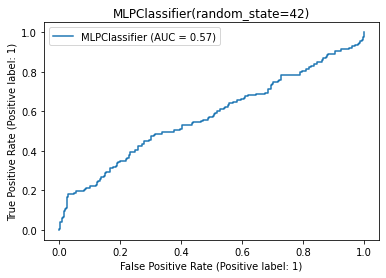

Training KNeighborsClassifier(n_neighbors=3)
Score Val: 0.7285714285714285
F1-Score Val: 0.4291845493562232


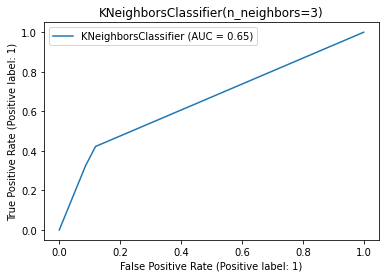

Training KNeighborsClassifier(metric='manhattan', n_neighbors=3, weights='distance')
Score Val: 0.736734693877551
F1-Score Val: 0.46473029045643155


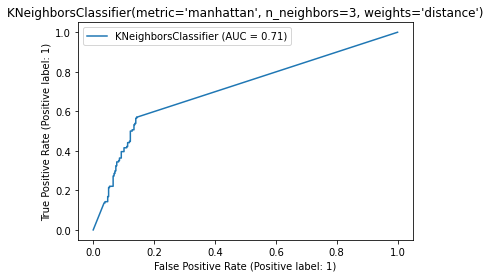

Training KNeighborsClassifier(metric='euclidean', n_neighbors=11)
Score Val: 0.7122448979591837
F1-Score Val: 0.5523809523809525


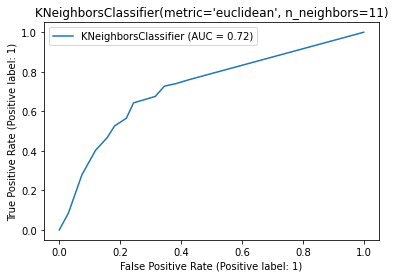

Training RandomForestClassifier(n_estimators=90, random_state=42)
Score Val: 0.7061224489795919
F1-Score Val: 0.1325301204819277


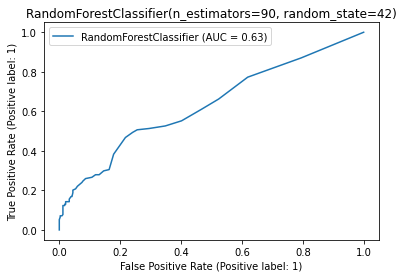

Training GradientBoostingClassifier(random_state=42)
Score Val: 0.7061224489795919
F1-Score Val: 0.2087912087912088


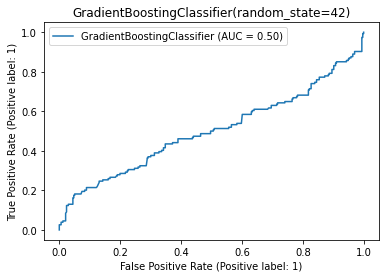

Training AdaBoostClassifier(random_state=42)
Score Val: 0.6755102040816326
F1-Score Val: 0.11173184357541897


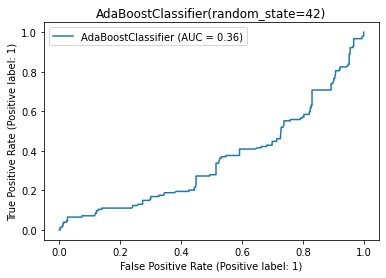

Training LinearSVC(max_iter=2000, random_state=42)
Score Val: 0.7183673469387755
F1-Score Val: 0.41025641025641024


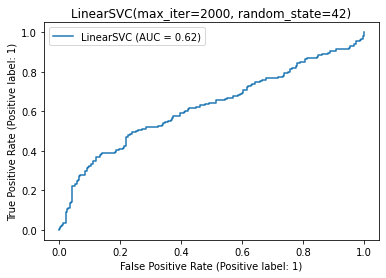

In [343]:
log = LogisticRegression()
mlp = MLPClassifier(random_state=42)
knn = KNeighborsClassifier(n_neighbors=3)
knn_best1 = KNeighborsClassifier(metric='manhattan', n_neighbors=3, weights='distance')
knn_best2 = KNeighborsClassifier(metric='euclidean', n_neighbors=11, weights='uniform')
rfc = RandomForestClassifier(n_estimators=90,random_state=42)
gbc = GradientBoostingClassifier(random_state=42)
ada = AdaBoostClassifier(random_state=42)
svc = LinearSVC(random_state=42, max_iter=2000)
#xgb = XGBClassifier()

#estimators = [log,mlp,knn,rfc,gbc,ada,svc,xgb]
#estimators = [log,mlp,knn,rfc,gbc,ada,svc]
estimators = [log,mlp,knn,knn_best1,knn_best2,rfc,gbc,ada, svc]
#estimators = [log]

df_scores = pd.DataFrame()

# Evaluate each model on both test and validation set 
for estimator in estimators:
    print("Training {}".format(estimator))
    #estimator.fit(X_train,y_train)
    estimator.fit(X,y)
    
    #y_score_test = estimator.fit(X_train,y_train).decision_function(X_test)
    #y_score_val = estimator.fit(X_train,y_train).decision_function(X_val)
    
    #y_pred_test = estimator.predict(X_test)
    y_pred_val = estimator.predict(X_val)
    #print("Confusion Matrix: {}".format(confusion_matrix(y_test, y_pred_test)))
    #print("Score Test: {}".format(estimator.score(X_test,y_test)))
    print("Score Val: {}".format(estimator.score(X_val,y_val)))
    #print("F1-Score Test: {}".format(f1_score(y_test, y_pred_test)))
    print("F1-Score Val: {}".format(f1_score(y_val, y_pred_val)))
    
    #Plot ROC Curve
    fig, ax = plt.subplots()
    
    #RocCurveDisplay.from_estimator(estimator, X_test, y_test, ax=ax)
    RocCurveDisplay.from_estimator(estimator, X_val, y_val, ax=ax)
    
    plt.title(estimator)
    plt.legend()
    plt.show()

In [344]:
grid_params = {'n_neighbors': [3, 5, 11, 19], 
               'weights': ['uniform', 'distance'], 
               'metric': ['euclidean', 'manhattan']
              }

gs = GridSearchCV(KNeighborsClassifier(), 
                  grid_params, 
                  verbose=1, 
                  cv=3, 
                  n_jobs=-1
                 )

gs_results = gs.fit(X, y)

Fitting 3 folds for each of 16 candidates, totalling 48 fits


In [345]:
gs_results.best_score_

0.6501831501831501

In [346]:
gs_results.best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=11)

In [347]:
gs_results.best_params_

{'metric': 'manhattan', 'n_neighbors': 11, 'weights': 'uniform'}

# Conclustions